## Customer Churn Prediction Using Machine Learning
url:https://www.kaggle.com/c/customer-churn-prediction-2020/data

## Business Question

How earlier can we predict our customers who are more likely to churn?

## Data Question

1.Based on the historical customer data trying various machine learning algorithms which model could give us the highest accuracy on predicting  the customers who are more likely to quit the subscription?

2.What are the underlying  factors which influences the customers to churn?

## INPUT VARIABLES

state  -   US state of customer residence

account_length -  Number of months the customer has been with the current telco provider

area_code  - area_code_AAA" where AAA = 3 digit area code.

international_plan - The customer has the  international plan.

voice_mail_plan - The customer has voice mail plan.

number_vmail_messages -  Number of voice-mail messages.

total_day_minutes - Total minutes of day calls.

total_day_calls - Total minutes of day calls.

total_day_charge - Total charge of day calls.

total_eve_minutes - Total minutes of evening calls.

total_eve_calls - Total number of evening calls.

total_eve_charge - Total charge of evening calls.

total_night_minutes - Total minutes of night calls.

total_night_calls - Total number of night calls.

total_night_charge - Total charge of night calls.

total_intl_minutes - Total minutes of international calls.

total_intl_calls - Total number of international calls.

total_intl_charge - Total charge of international calls

number_customer_service_calls -  Number of calls to customer service


## OUTPUT VARIABLE

### churn - (Yes/No)

**Importing the necessary libraries**

In [246]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
# Disable warnings 
import warnings
warnings.filterwarnings('ignore')

In [247]:
C_train=pd.read_csv("train-2.csv")

In [248]:
C_train.head()

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
0,OH,107,area_code_415,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,no
1,NJ,137,area_code_415,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,no
2,OH,84,area_code_408,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,no
3,OK,75,area_code_415,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,no
4,MA,121,area_code_510,no,yes,24,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,no


In [249]:
C_train.shape# The dataset has 4250 rows and 20 columns

(4250, 20)

In [250]:
# There are 3652 of non churners and 598 churners
C_train['churn'].value_counts()

no     3652
yes     598
Name: churn, dtype: int64

In [251]:
#no null values in the dataset
C_train.isnull().sum()


state                            0
account_length                   0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_minutes                0
total_day_calls                  0
total_day_charge                 0
total_eve_minutes                0
total_eve_calls                  0
total_eve_charge                 0
total_night_minutes              0
total_night_calls                0
total_night_charge               0
total_intl_minutes               0
total_intl_calls                 0
total_intl_charge                0
number_customer_service_calls    0
churn                            0
dtype: int64

In [252]:
#First 5 records of the dataset
C_train.head()

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
0,OH,107,area_code_415,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,no
1,NJ,137,area_code_415,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,no
2,OH,84,area_code_408,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,no
3,OK,75,area_code_415,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,no
4,MA,121,area_code_510,no,yes,24,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,no


### Renaming the column name

In [253]:
#List of column names in the dataset
C_train.columns

Index(['state', 'account_length', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

In [254]:
# Function written for displaying the information of the data
def dataoveriew(df, message):
    print(f'{message}:\n')
    print("Rows:", df.shape[0])
    print("\nNumber of features:", df.shape[1])
    print("\nFeatures:")
    print(df.columns.tolist())
    print("\nMissing values:", df.isnull().sum().values.sum())
    print("\nUnique values:")
    print(df.nunique())
    print("\nDatatypes of the variables:")
    print(df.dtypes)

In [255]:
dataoveriew(C_train, 'Overiew of the dataset')

Overiew of the dataset:

Rows: 4250

Number of features: 20

Features:
['state', 'account_length', 'area_code', 'international_plan', 'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes', 'total_day_calls', 'total_day_charge', 'total_eve_minutes', 'total_eve_calls', 'total_eve_charge', 'total_night_minutes', 'total_night_calls', 'total_night_charge', 'total_intl_minutes', 'total_intl_calls', 'total_intl_charge', 'number_customer_service_calls', 'churn']

Missing values: 0

Unique values:
state                              51
account_length                    215
area_code                           3
international_plan                  2
voice_mail_plan                     2
number_vmail_messages              46
total_day_minutes                1843
total_day_calls                   120
total_day_charge                 1843
total_eve_minutes                1773
total_eve_calls                   123
total_eve_charge                 1572
total_night_minutes              1757
to

## 2. Exploratory Data Analysis

In [132]:
import plotly.offline as py # visualization
py.init_notebook_mode(connected=True) 
import plotly.graph_objs as go # visualization
trace = go.Pie(labels = C_train["churn"].value_counts().keys().tolist(),
               values = C_train["churn"].value_counts().values.tolist(),
               marker = dict(colors = ['LightSkyBlue','MediumPurple'],
                             line = dict(color = "white", width =  1.3)
                            ),
               rotation = 90,
               hoverinfo = "label+value+text",
               hole = .5
              )
layout = go.Layout(dict(title = "Customer churn in whole dataset",
                        plot_bgcolor = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                       )
                  )
data = [trace]
fig = go.Figure(data = data, layout = layout)
py.iplot(fig)

### Quick data Profile

In [258]:
#pandas_profiling.ProfileReport(data_df.reset_index(), check_correlation=False)
from pandas_profiling import ProfileReport
profile=pandas_profiling.ProfileReport(C_train)
profile


In [134]:
C_train.dtypes

state                             object
account_length                     int64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

In [135]:
C_train.shape

(4250, 20)

## Exploratory Data Analysis

### BoxPlot

In [136]:
#numerical columns
num_var = C_train.columns.difference(['state','area_code','international_plan','voice_mail_plan', 'churn'])
num_var

Index(['account_length', 'number_customer_service_calls',
       'number_vmail_messages', 'total_day_calls', 'total_day_charge',
       'total_day_minutes', 'total_eve_calls', 'total_eve_charge',
       'total_eve_minutes', 'total_intl_calls', 'total_intl_charge',
       'total_intl_minutes', 'total_night_calls', 'total_night_charge',
       'total_night_minutes'],
      dtype='object')

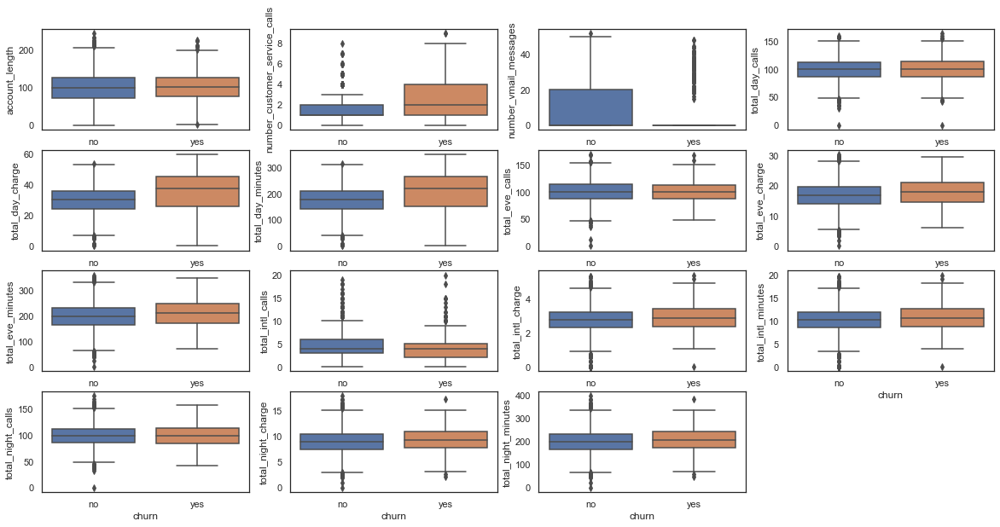

In [137]:
# we can see the visibility of the outliers in each  variable.
plt.figure(figsize=(20,10))
for i, c in enumerate(num_var):
    plt.subplot(4,4, i+1)
    sns.boxplot(x='churn', y=c, data=C_train)
plt.show()

###  Removing Outliers

Look at the upper extreme,lower extreme,inter quartile range ie.uper quartile and the lower quartile.
We are observing otliers in all the variables with churning and non churning customers.In this project we are not going to take the outliers but if in future required the code is given below to getrid of outliers and the other  process take in place automatically running t he code below.
There are three ways to detect the illegitimate outlier they are
1.using scatter plots,2.using Z score & 3.using the IQR interquartile range

#### Account Length

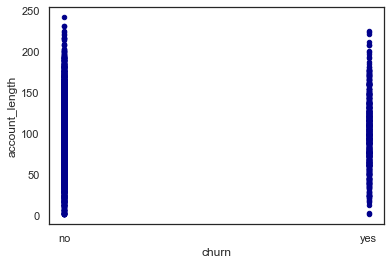

In [138]:
df =C_train.copy()#making a copy of C_train
df.plot.scatter(x='churn',y='account_length',c='DarkBlue')                                        

In [18]:
#Using the IQR interquartile range

Q1 = df.account_length.quantile(0.25)
Q3 = df.account_length.quantile(0.75)
Q1, Q3

(73.0, 127.0)

In [19]:
IQR = Q3 - Q1
IQR

54.0

In [20]:
lower_limit = Q1 - 1.5*IQR
upper_limit = Q3 + 1.5*IQR
lower_limit, upper_limit

(-8.0, 208.0)

In [21]:
df[(df.account_length<lower_limit)|(df.account_length>upper_limit)]

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
197,WY,215,area_code_510,no,no,0,83.6,148,14.21,120.9,91,10.28,226.6,110,10.20,10.7,9,2.89,0,no
256,SD,209,area_code_415,no,no,0,227.2,128,38.62,258.4,92,21.96,183.5,74,8.26,8.9,4,2.40,3,no
343,DE,224,area_code_510,yes,no,0,171.5,99,29.16,160.0,103,13.60,212.4,102,9.56,5.0,2,1.35,1,yes
684,UT,243,area_code_510,no,no,0,95.5,92,16.24,163.7,63,13.91,264.2,118,11.89,6.6,6,1.78,2,no
877,TX,217,area_code_408,no,no,0,176.4,115,29.99,158.8,128,13.50,306.6,107,13.80,9.3,3,2.51,4,no
1193,NM,232,area_code_408,no,no,0,165.6,104,28.15,195.9,115,16.65,118.3,77,5.32,11.8,3,3.19,1,no
1304,MI,225,area_code_415,no,no,0,165.4,106,28.12,273.7,109,23.26,210.0,93,9.45,8.7,3,2.35,0,yes
1472,WY,225,area_code_415,no,no,0,182.7,142,31.06,246.5,63,20.95,218.0,103,9.81,8.8,2,2.38,1,no
1593,ID,224,area_code_510,no,no,0,111.4,133,18.94,175.0,66,14.88,217.2,106,9.77,5.5,6,1.49,3,no
1828,SC,212,area_code_415,no,no,0,226.0,127,38.42,304.6,83,25.89,181.2,132,8.15,12.6,4,3.40,2,yes


In [22]:
df_no_outlier = df[((df.account_length<lower_limit)>lower_limit)&((df.account_length<lower_limit)<upper_limit)]
df_no_outlier

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
0,OH,107,area_code_415,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,no
1,NJ,137,area_code_415,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,no
2,OH,84,area_code_408,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,no
3,OK,75,area_code_415,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,no
4,MA,121,area_code_510,no,yes,24,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4245,MT,83,area_code_415,no,no,0,188.3,70,32.01,243.8,88,20.72,213.7,79,9.62,10.3,6,2.78,0,no
4246,WV,73,area_code_408,no,no,0,177.9,89,30.24,131.2,82,11.15,186.2,89,8.38,11.5,6,3.11,3,no
4247,NC,75,area_code_408,no,no,0,170.7,101,29.02,193.1,126,16.41,129.1,104,5.81,6.9,7,1.86,1,no
4248,HI,50,area_code_408,no,yes,40,235.7,127,40.07,223.0,126,18.96,297.5,116,13.39,9.9,5,2.67,2,no


In [23]:
df_no_outlier.shape

(4250, 20)

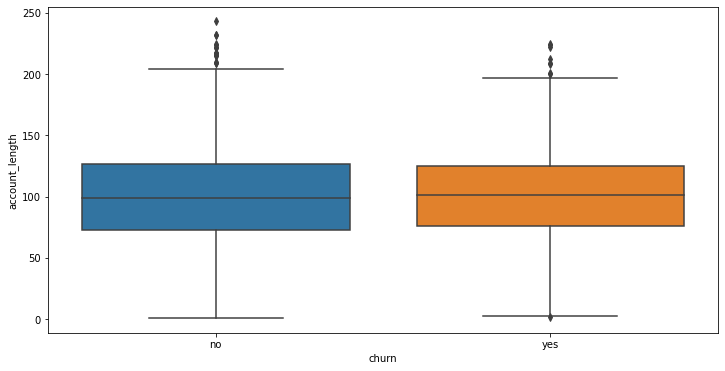

In [24]:
plt.rcParams['figure.figsize']=12,6
sns.boxplot(x="churn", y='account_length', data=df_no_outlier)   

In [25]:
num_var

Index(['account_length', 'number_customer_service_calls',
       'number_vmail_messages', 'total_day_calls', 'total_day_charge',
       'total_day_minutes', 'total_eve_calls', 'total_eve_charge',
       'total_eve_minutes', 'total_intl_calls', 'total_intl_charge',
       'total_intl_minutes', 'total_night_calls', 'total_night_charge',
       'total_night_minutes'],
      dtype='object')

Q1: 1.0
Q3:  2.0
Upper Extreme: 3.5
Lower Extreme: -0.5
IQR: 1.0
Shape (4250, 20)


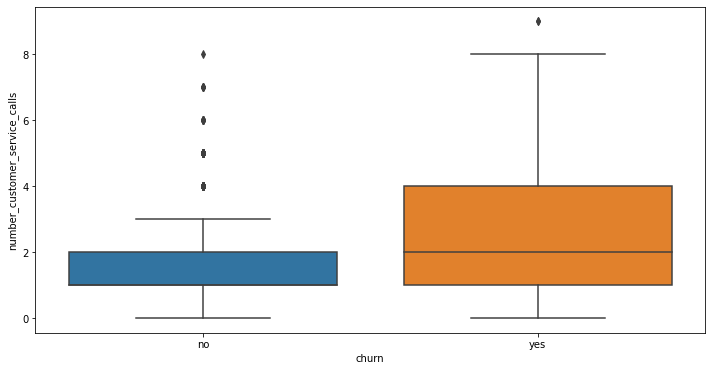

In [26]:
Q1 = df.number_customer_service_calls.quantile(0.25)
Q3 = df.number_customer_service_calls.quantile(0.75)
IQR = Q3 - Q1
lower_limit = Q1 - 1.5*IQR
upper_limit = Q3 + 1.5*IQR
df_no_outlier = df[((df.number_customer_service_calls<lower_limit)>lower_limit)&((df.number_customer_service_calls<lower_limit)<upper_limit)]
print("Q1:",Q1)
print("Q3: ",Q3)
print("Upper Extreme:",upper_limit)
print("Lower Extreme:",lower_limit)
print("IQR:",IQR)
print("Shape",df.shape)
plt.rcParams['figure.figsize']=12,6
sns.boxplot(x="churn", y='number_customer_service_calls', data=df_no_outlier)   

In [27]:
#Description of the data
C_train.describe().T

,count,mean,std,min,25%,50%,75%,max
account_length,4250.0,100.236235,39.698401,1.0,73.0000,100.00,127.0000,243.00
number_vmail_messages,4250.0,7.631765,13.439882,0.0,0.0000,0.00,16.0000,52.00
total_day_minutes,4250.0,180.259600,54.012373,0.0,143.3250,180.45,216.2000,351.50
total_day_calls,4250.0,99.907294,19.850817,0.0,87.0000,100.00,113.0000,165.00
total_day_charge,4250.0,30.644682,9.182096,0.0,24.3650,30.68,36.7500,59.76
total_eve_minutes,4250.0,200.173906,50.249518,0.0,165.9250,200.70,233.7750,359.30
total_eve_calls,4250.0,100.176471,19.908591,0.0,87.0000,100.00,114.0000,170.00
total_eve_charge,4250.0,17.015012,4.271212,0.0,14.1025,17.06,19.8675,30.54
total_night_minutes,4250.0,200.527882,50.353548,0.0,167.2250,200.45,234.7000,395.00
total_night_calls,4250.0,99.839529,20.093220,0.0,86.0000,100.00,113.0000,175.00


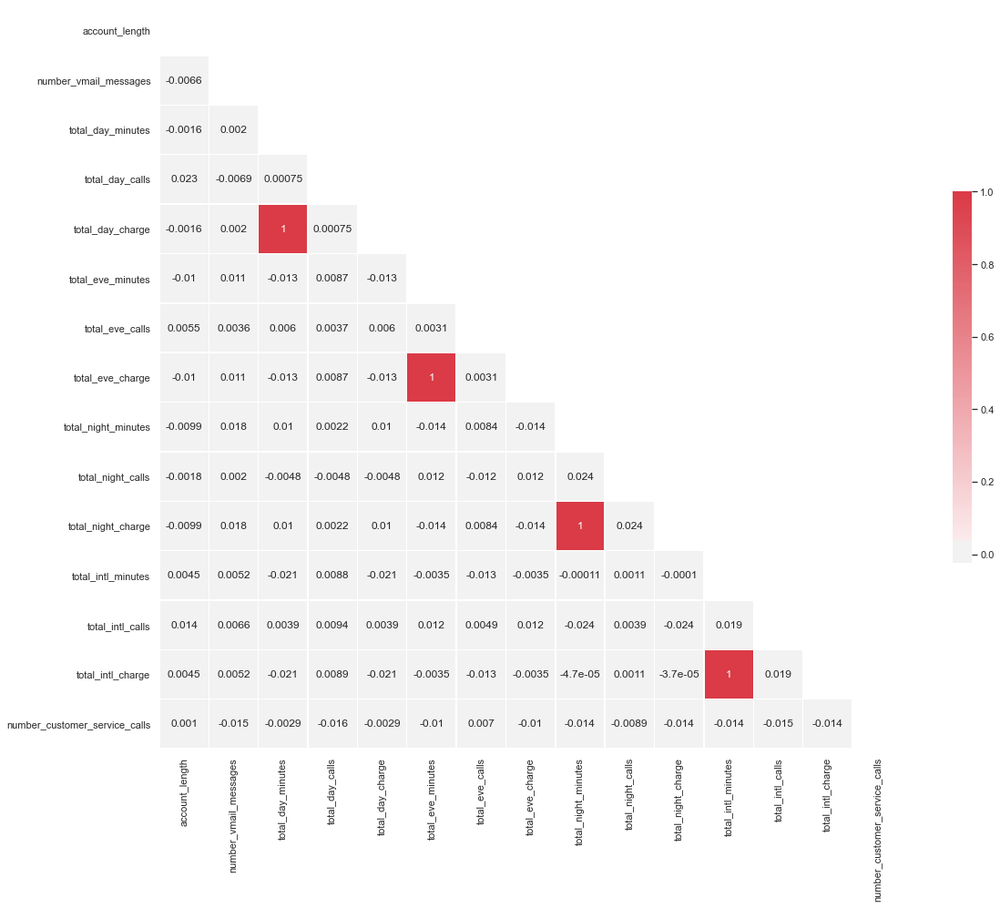

In [28]:

# Copied code from seaborn examples
# https://seaborn.pydata.org/examples/many_pairwise_correlations.html
sns.set(style="white")

# Generate a mask for the upper triangle
mask = np.zeros_like(df.corr(), dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 15))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(df.corr(), mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

plt.show();


### We dont see much variables correlated to each other except (total_international minutes is highly correlated with total_int_charges, total_night_minutes with tatal_night_charge,total_eve_minutes withtotal evening charge,total_day_minutes with total_day_charge).We can either exclude the highy correlated variable or keep thse for futher proccess.

## Transforming Data

### Normalize Numeric Columns

In [29]:
C_train.dtypes

state                             object
account_length                     int64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

In [139]:
# Create Dummy Variables separately for state and area code
#st_area = pd.get_dummies(C_train, columns=['state', 'area_code'])
state_dum = pd.get_dummies(C_train['state'])
area_dum = pd.get_dummies(C_train['area_code'])

In [140]:
#Dummy variable for state
state_dum.head()

,AK,AL,AR,AZ,CA,CO,CT,DC,DE,FL,...,SD,TN,TX,UT,VA,VT,WA,WI,WV,WY
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [141]:
#Dummy vaiable for area_code
area_dum.head()

,area_code_408,area_code_415,area_code_510
0,0,1,0
1,0,1,0
2,1,0,0
3,0,1,0
4,0,0,1


### Preproccessing Numeric data

In [142]:
#Numeric input features
numeric = C_train[['account_length','number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls']]
from sklearn.preprocessing import MinMaxScaler
# fit scaler on training data
norm = MinMaxScaler().fit(numeric)
# transform training data
normal_numeric_data = norm.transform(numeric)
cols = numeric.columns.values
# normalized data to dataframe
normal_numeric_data = pd.DataFrame(data = normal_numeric_data, columns = cols)
normal_numeric_data.head(5)

,account_length,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
0,0.438017,0.500000,0.459744,0.745455,0.459672,0.544114,0.605882,0.544204,0.644051,0.588571,0.644344,0.685,0.15,0.685185,0.111111
1,0.561983,0.000000,0.692461,0.690909,0.692436,0.337323,0.647059,0.337263,0.411646,0.594286,0.411930,0.610,0.25,0.609259,0.000000
2,0.342975,0.000000,0.851778,0.430303,0.851740,0.172279,0.517647,0.172233,0.498481,0.508571,0.498593,0.330,0.35,0.329630,0.222222
3,0.305785,0.000000,0.474253,0.684848,0.474230,0.412747,0.717647,0.412901,0.473165,0.691429,0.473270,0.505,0.15,0.505556,0.333333
4,0.495868,0.461538,0.620768,0.533333,0.620649,0.969942,0.635294,0.969876,0.538228,0.674286,0.538548,0.375,0.35,0.375926,0.333333


### Standardizing Categorical data

In [143]:
# label encoding because it has a binary class response(yes/no) in categorical feature
from sklearn.preprocessing import LabelEncoder
labelencoder = LabelEncoder()
Categorical = C_train[['international_plan','voice_mail_plan','churn']]
Categorical = Categorical.apply(LabelEncoder().fit_transform)
Categorical.head(5)

,international_plan,voice_mail_plan,churn
0,0,1,0
1,0,0,0
2,1,0,0
3,1,0,0
4,0,1,0


In [144]:
#Concatenating  numeriacal & categorical into a final dataframe
Final_df =  pd.concat([state_dum,area_dum,normal_numeric_data, Categorical], axis=1)
Final_df.head()

,AK,AL,AR,AZ,CA,CO,CT,DC,DE,FL,...,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,international_plan,voice_mail_plan,churn
0,0,0,0,0,0,0,0,0,0,0,...,0.644051,0.588571,0.644344,0.685,0.15,0.685185,0.111111,0,1,0
1,0,0,0,0,0,0,0,0,0,0,...,0.411646,0.594286,0.411930,0.610,0.25,0.609259,0.000000,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0.498481,0.508571,0.498593,0.330,0.35,0.329630,0.222222,1,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0.473165,0.691429,0.473270,0.505,0.15,0.505556,0.333333,1,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0.538228,0.674286,0.538548,0.375,0.35,0.375926,0.333333,0,1,0


In [145]:
# There are 72 columns in final dataframe
Final_df.shape

(4250, 72)

In [146]:
#List of columns in final dataset
Final_df.columns

Index(['AK', 'AL', 'AR', 'AZ', 'CA', 'CO', 'CT', 'DC', 'DE', 'FL', 'GA', 'HI',
       'IA', 'ID', 'IL', 'IN', 'KS', 'KY', 'LA', 'MA', 'MD', 'ME', 'MI', 'MN',
       'MO', 'MS', 'MT', 'NC', 'ND', 'NE', 'NH', 'NJ', 'NM', 'NV', 'NY', 'OH',
       'OK', 'OR', 'PA', 'RI', 'SC', 'SD', 'TN', 'TX', 'UT', 'VA', 'VT', 'WA',
       'WI', 'WV', 'WY', 'area_code_408', 'area_code_415', 'area_code_510',
       'account_length', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'international_plan',
       'voice_mail_plan', 'churn'],
      dtype='object')

## SMOTE - Synthetic Minority Over-sampling Technique
Oversampling teqniques usally used for the datasets which are imbalance(86% non_churners and 14% Churners).

In [147]:
# dropping churn for variable X  & Only churn for variable y(Target variable)
X=Final_df.drop('churn',axis=1)
y=Final_df['churn']
# Splitting the dataset into the Training set and Test set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size = 0.25, random_state = 42,stratify=y)
#We are applying th esomote technique to only for traininh set
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state=42)
X_train_Smote, y_train_Smote= sm.fit_resample(X_train, y_train)

In [148]:
#We can observe the increment in the data points afeter the smote
X_train_Smote.shape,y_train_Smote.shape

((5478, 71), (5478,))

In [149]:
#Its a orginal training data which has 3187 rows and 71 columns
X_train.shape,y_train.shape

((3187, 71), (3187,))

In [150]:
# y_train which has 2739 of non_churners and 448 of churners instances
y_train.value_counts()

0    2739
1     448
Name: churn, dtype: int64

In [151]:
# y_train with smote which has 2739 of non_churners and 2739 of churners instances
y_train_Smote.value_counts()

1    2739
0    2739
Name: churn, dtype: int64

In [152]:
#we are going to do predictions on X_test data(1063 instance) and y_test data(1063 instances)
X_test.shape,y_test.shape

((1063, 71), (1063,))

## Baseline model Building

**Basemodel Build, Score & Comparision after hyperparameter Tunning through GridsearchCv**

In [153]:
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier,AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble.bagging import BaggingClassifier
import xgboost as xgb
from xgboost import XGBClassifier
from catboost import CatBoostClassifier

In [154]:

from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.metrics import roc_auc_score, roc_curve,scorer, f1_score, precision_score, recall_score
from sklearn.metrics import precision_recall_curve, average_precision_score

I am not using synthetic data in this validation data!
Just like with our testing data, we want to validate our model using only real data. This means that we only want our SMOTE data in the training folds and not in the validation folds. 
This imbalenced-learn module will help us here for data handeling know as the pipeline module. Just include the SMOTE process and your model into the pipeline and the module will handle the rest. You can use either the Pipeline or make_pipeline function for this task.
**from imblearn.pipeline import make_pipeline
pipeline = make_pipeline(smt, clf)
evaluate_model(X_train, y_train, pipeline)**

### SMOTE Oversampling teqnique for imbalance dataset

In [155]:

X=Final_df.drop('churn',axis=1)
y=Final_df['churn']
# Splitting the dataset into the Training set and Test set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size = 0.25,random_state = 42,stratify=y)
#Dataset is imbalance
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state=42)
X_train_Smote, y_train_Smote= sm.fit_resample(X_train, y_train)

In [156]:
X.shape,y.shape


((4250, 71), (4250,))

In [157]:
X_train_Smote.shape, y_train_Smote.shape

((5478, 71), (5478,))

In [158]:
X_test.shape

(1063, 71)

In [159]:
from mlxtend.plotting import plot_confusion_matrix
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report, confusion_matrix 
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import accuracy_score
import plotly.express as px
from sklearn.metrics import roc_curve, auc
def evaluate_model(X_train, y_train, model):
    #X_train, X_test, y_train, y_test = train_test_split(X, y,test_size = 0.25, random_state = 42,stratify=y)
    model.fit(X_train, y_train)
    preds = model.predict(X_test)
    scores = cross_val_score(model, X_train, y_train, cv=3, scoring="accuracy")
    diff = scores.mean() - model.score(X_test, y_test)
    SD = diff / scores.std()
    
    print(f"Training Score:{model.score(X_train, y_train)}")
    print(f"Cross V Score: {scores.mean()} +/- {scores.std()}")
    print(f"Testing Score: {model.score(X_test, y_test)}")
    print(f"Cross & Test Diff: {diff}")
    print(f"Standard Deviations Away: {SD}")
    #print(f"Confusion Matrix: {confusion_matrix(y_test, preds)}")
    print(f"Report: {classification_report(y_test, preds)}")
    print(f"Accuracy Score: {accuracy_score(y_test, preds)}")
    
    #Cofusion Matrix
    cf_matrix = confusion_matrix(y_test, preds)
    group_names = ['True Neg','False Pos','False Neg','True Pos']
    group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]
    labels = [f"{v1}\n{v2}\n{v3}"for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sns.heatmap(cf_matrix, annot=labels, fmt="", cmap='Blues')
    
    
    #Plot ROC Curve
    y_pred_prob = model.predict_proba(X_test)[:,1]
    fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)

    fig = px.area(x=fpr, y=tpr,
    title=f'ROC Curve (AUC={auc(fpr, tpr):.4f})',
    labels=dict(x='False Positive Rate(1-Specificity)', y='True Positive Rate(Sensitivity)'),
    width=700, height=500
    
       )
    fig.add_shape(
    type='line', line=dict(dash='dash'),
    x0=0, x1=1, y0=0, y1=1
     )

    fig.update_yaxes(scaleanchor="x", scaleratio=1)
    fig.update_xaxes(constrain='domain')
    fig.show()

## 1.SVM

Training Score:0.8594289300282397
Cross V Score: 0.8591152260093695 +/- 0.0004161163122029976
Testing Score: 0.8588899341486359
Cross & Test Diff: 0.00022529186073361185
Standard Deviations Away: 0.5414155949351627
Report:               precision    recall  f1-score   support

           0       0.86      1.00      0.92       913
           1       0.00      0.00      0.00       150

    accuracy                           0.86      1063
   macro avg       0.43      0.50      0.46      1063
weighted avg       0.74      0.86      0.79      1063

Accuracy Score: 0.8588899341486359


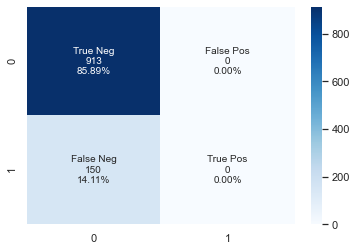

In [160]:
SVM = SVC(kernel = 'linear', random_state =42,probability=True)
evaluate_model(X_train, y_train, SVM)

## 2.SVM SMOTE

Training Score:0.8355239138371668
Cross V Score: 0.8216502373128879 +/- 0.024937738388826933
Testing Score: 0.7845719661335842
Cross & Test Diff: 0.037078271179303735
Standard Deviations Away: 1.4868337537744092
Report:               precision    recall  f1-score   support

           0       0.93      0.81      0.87       913
           1       0.36      0.65      0.46       150

    accuracy                           0.78      1063
   macro avg       0.65      0.73      0.66      1063
weighted avg       0.85      0.78      0.81      1063

Accuracy Score: 0.7845719661335842


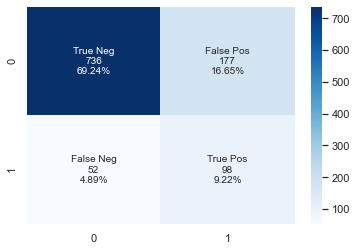

In [259]:
SVM_SMOTE = SVC(kernel = 'linear', random_state = 42,probability=True)
evaluate_model(X_train_Smote, y_train_Smote, SVM_SMOTE)

## 3.Logistic Regression

Training Score:0.8788829620332601
Cross V Score: 0.8707232193527775 +/- 0.009905693332690452
Testing Score: 0.8513640639698965
Cross & Test Diff: 0.01935915538288102
Standard Deviations Away: 1.95434632717657
Report:               precision    recall  f1-score   support

           0       0.88      0.95      0.92       913
           1       0.45      0.23      0.31       150

    accuracy                           0.85      1063
   macro avg       0.67      0.59      0.61      1063
weighted avg       0.82      0.85      0.83      1063

Accuracy Score: 0.8513640639698965


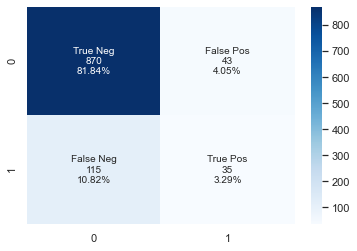

In [260]:
logmodel = LogisticRegression(C=5,random_state =42)
evaluate_model(X_train, y_train, logmodel)

## 4.Logistic Regression - SMOTE

Training Score:0.8435560423512231
Cross V Score: 0.826031398320555 +/- 0.027310359548416287
Testing Score: 0.7845719661335842
Cross & Test Diff: 0.0414594321869709
Standard Deviations Away: 1.5180844511940932
Report:               precision    recall  f1-score   support

           0       0.93      0.81      0.87       913
           1       0.35      0.61      0.45       150

    accuracy                           0.78      1063
   macro avg       0.64      0.71      0.66      1063
weighted avg       0.85      0.78      0.81      1063

Accuracy Score: 0.7845719661335842


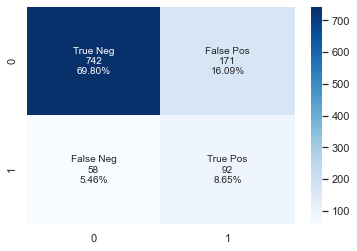

In [261]:
logmodel_SMOTE = LogisticRegression(C=5,random_state =42)
evaluate_model(X_train_Smote, y_train_Smote, logmodel_SMOTE)

## 5.GaussianNB

In [262]:
Gaussian = GaussianNB()

Training Score:0.6071540633824913
Cross V Score: 0.4669222533437978 +/- 0.08585181776554646
Testing Score: 0.5569143932267169
Cross & Test Diff: -0.0899921398829191
Standard Deviations Away: -1.0482263768564515
Report:               precision    recall  f1-score   support

           0       0.91      0.54      0.68       913
           1       0.19      0.67      0.30       150

    accuracy                           0.56      1063
   macro avg       0.55      0.61      0.49      1063
weighted avg       0.81      0.56      0.62      1063

Accuracy Score: 0.5569143932267169


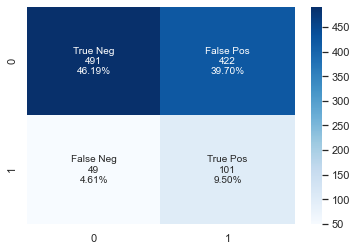

In [263]:
evaluate_model(X_train, y_train,Gaussian)

## 6.Gaussian_SMOTE

Training Score:0.6805403431909456
Cross V Score: 0.6604600219058051 +/- 0.05108680779854913
Testing Score: 0.48071495766698025
Cross & Test Diff: 0.17974506423882486
Standard Deviations Away: 3.5184242661552565
Report:               precision    recall  f1-score   support

           0       0.91      0.44      0.59       913
           1       0.18      0.73      0.28       150

    accuracy                           0.48      1063
   macro avg       0.54      0.58      0.44      1063
weighted avg       0.80      0.48      0.55      1063

Accuracy Score: 0.48071495766698025


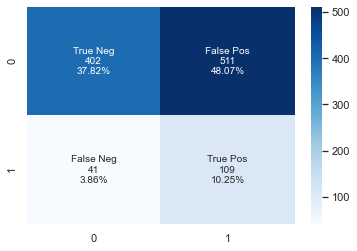

In [264]:
Gaussian_SMOTE = GaussianNB()
evaluate_model(X_train_Smote, y_train_Smote,Gaussian_SMOTE)

## 7.DecisionTreeClassifier

Training Score:1.0
Cross V Score: 0.9143403731872568 +/- 0.007561829461641054
Testing Score: 0.9012229539040452
Cross & Test Diff: 0.01311741928321164
Standard Deviations Away: 1.7346885895473396
Report:               precision    recall  f1-score   support

           0       0.95      0.94      0.94       913
           1       0.64      0.67      0.66       150

    accuracy                           0.90      1063
   macro avg       0.79      0.81      0.80      1063
weighted avg       0.90      0.90      0.90      1063

Accuracy Score: 0.9012229539040452


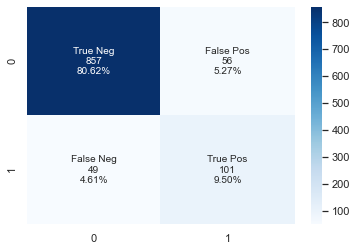

In [265]:
dt = DecisionTreeClassifier(random_state =42)
evaluate_model(X_train,y_train,dt)

## 8. DecisionTree - SMOTE

Training Score:1.0
Cross V Score: 0.8985031033223804 +/- 0.003750025298315816
Testing Score: 0.8692380056444027
Cross & Test Diff: 0.02926509767797769
Standard Deviations Away: 7.803973400158398
Report:               precision    recall  f1-score   support

           0       0.95      0.89      0.92       913
           1       0.53      0.73      0.61       150

    accuracy                           0.87      1063
   macro avg       0.74      0.81      0.77      1063
weighted avg       0.89      0.87      0.88      1063

Accuracy Score: 0.8692380056444027


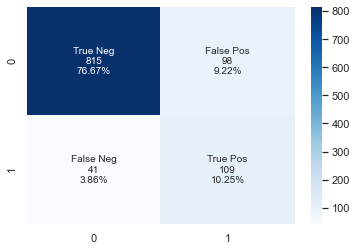

In [266]:
dt_SMOTE = DecisionTreeClassifier(random_state =42)
evaluate_model(X_train_Smote,y_train_Smote,dt_SMOTE)

## 9. RandomForestClassifier

Training Score:1.0
Cross V Score: 0.9341070027088172 +/- 0.0007939124856888802
Testing Score: 0.9482596425211665
Cross & Test Diff: -0.014152639812349266
Standard Deviations Away: -17.826448213708314
Report:               precision    recall  f1-score   support

           0       0.94      1.00      0.97       913
           1       1.00      0.63      0.78       150

    accuracy                           0.95      1063
   macro avg       0.97      0.82      0.87      1063
weighted avg       0.95      0.95      0.94      1063

Accuracy Score: 0.9482596425211665


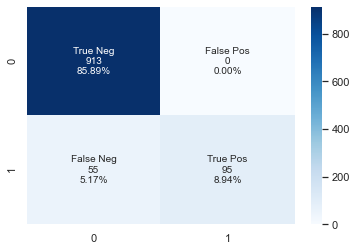

In [267]:
RFC = RandomForestClassifier(random_state =42)
evaluate_model(X_train,y_train,RFC)

## 10.RandomForest - SMOTE

Training Score:1.0
Cross V Score: 0.9344651332603139 +/- 0.005240124167363049
Testing Score: 0.9397930385700847
Cross & Test Diff: -0.005327905309770786
Standard Deviations Away: -1.016751729463676
Report:               precision    recall  f1-score   support

           0       0.96      0.97      0.97       913
           1       0.80      0.77      0.78       150

    accuracy                           0.94      1063
   macro avg       0.88      0.87      0.87      1063
weighted avg       0.94      0.94      0.94      1063

Accuracy Score: 0.9397930385700847


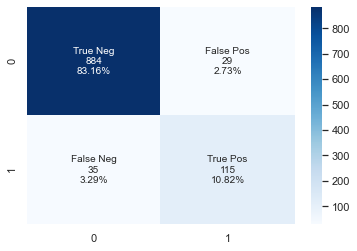

In [268]:
RFC_SMOTE = RandomForestClassifier(random_state =42)
evaluate_model(X_train_Smote,y_train_Smote,RFC_SMOTE)

## 11. AdaBoost

Training Score:0.9077502353310323
Cross V Score: 0.8860985768522799 +/- 0.006722060428484116
Testing Score: 0.8842897460018815
Cross & Test Diff: 0.0018088308503984019
Standard Deviations Away: 0.2690887518258013
Report:               precision    recall  f1-score   support

           0       0.91      0.97      0.93       913
           1       0.65      0.39      0.49       150

    accuracy                           0.88      1063
   macro avg       0.78      0.68      0.71      1063
weighted avg       0.87      0.88      0.87      1063

Accuracy Score: 0.8842897460018815


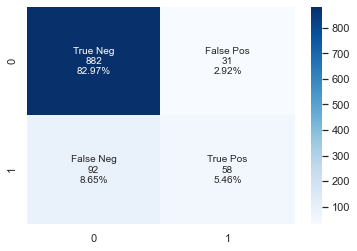

In [269]:

ADA = AdaBoostClassifier(random_state =42)
evaluate_model(X_train,y_train,ADA)

## 12.AdaBoost - SMOTE

Training Score:0.8893756845564075
Cross V Score: 0.872946330777656 +/- 0.02801032169232077
Testing Score: 0.8504233301975541
Cross & Test Diff: 0.022523000580101926
Standard Deviations Away: 0.8040964622793592
Report:               precision    recall  f1-score   support

           0       0.94      0.89      0.91       913
           1       0.48      0.63      0.54       150

    accuracy                           0.85      1063
   macro avg       0.71      0.76      0.73      1063
weighted avg       0.87      0.85      0.86      1063

Accuracy Score: 0.8504233301975541


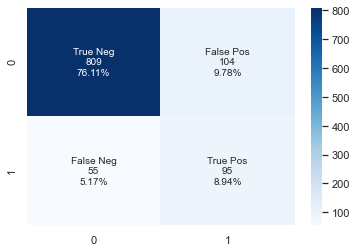

In [270]:
ADA_SMOTE = AdaBoostClassifier(random_state =42)
evaluate_model(X_train_Smote,y_train_Smote,ADA_SMOTE)

## 13. XGBOOST


Training Score:1.0
Cross V Score: 0.9526184347205761 +/- 0.0058329619074382975
Testing Score: 0.9567262464722484
Cross & Test Diff: -0.004107811751672297
Standard Deviations Away: -0.7042411414403276
Report:               precision    recall  f1-score   support

           0       0.96      0.99      0.98       913
           1       0.92      0.76      0.83       150

    accuracy                           0.96      1063
   macro avg       0.94      0.87      0.90      1063
weighted avg       0.96      0.96      0.95      1063

Accuracy Score: 0.9567262464722484


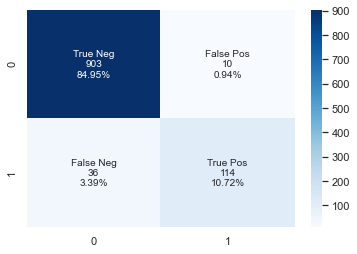

In [271]:
gbm = xgb.XGBClassifier(random_state =42)
evaluate_model(X_train,y_train,gbm)

## 14.XGBOOST with SMOTE

Training Score:1.0
Cross V Score: 0.9518072289156626 +/- 0.03486339439823862
Testing Score: 0.9567262464722484
Cross & Test Diff: -0.0049190175565857475
Standard Deviations Away: -0.14109405126754576
Report:               precision    recall  f1-score   support

           0       0.97      0.98      0.98       913
           1       0.89      0.79      0.84       150

    accuracy                           0.96      1063
   macro avg       0.93      0.89      0.91      1063
weighted avg       0.96      0.96      0.96      1063

Accuracy Score: 0.9567262464722484


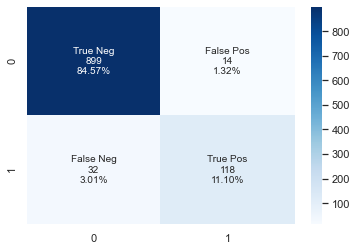

In [272]:

gbm_SMOTE = xgb.XGBClassifier(random_state =42)
evaluate_model(X_train_Smote,y_train_Smote,gbm_SMOTE)

## 15. XGBOOST with random parameters.

In [273]:
gbm_ran = xgb.XGBClassifier(learning_rate = 0.02,random_state =42,
    n_estimators = 100,
    max_depth = 4,
    min_child_weight = 2,
    gamma = 0.9,                        
    subsample = 0.8,
    colsample_bytree = 0.8,
    objective = 'binary:logistic',
    nthread = -1,
    scale_pos_weight = 1)

Training Score:0.9610919359899592
Cross V Score: 0.9491664201152856 +/- 0.0068469041421736565
Testing Score: 0.949200376293509
Cross & Test Diff: -3.395617822332664e-05
Standard Deviations Away: -0.004959347687398282
Report:               precision    recall  f1-score   support

           0       0.95      1.00      0.97       913
           1       0.98      0.65      0.78       150

    accuracy                           0.95      1063
   macro avg       0.96      0.83      0.88      1063
weighted avg       0.95      0.95      0.94      1063

Accuracy Score: 0.949200376293509


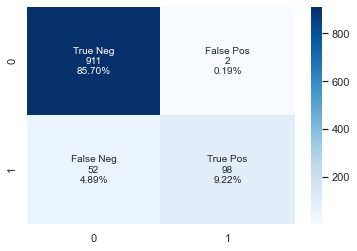

In [274]:
evaluate_model(X_train, y_train,gbm_ran )

## 16.XGBOOST_Smote with random parameters


Training Score:0.9916027747353049
Cross V Score: 0.9466958744067178 +/- 0.045972480655711724
Testing Score: 0.9576669802445907
Cross & Test Diff: -0.010971105837872974
Standard Deviations Away: -0.2386450694282885
Report:               precision    recall  f1-score   support

           0       0.96      0.99      0.98       913
           1       0.92      0.77      0.84       150

    accuracy                           0.96      1063
   macro avg       0.94      0.88      0.91      1063
weighted avg       0.96      0.96      0.96      1063

Accuracy Score: 0.9576669802445907


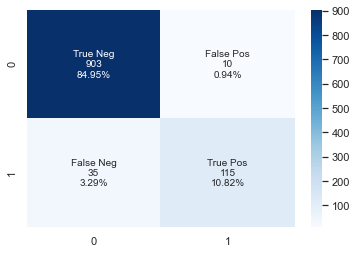

In [275]:
gbm_ran_SMOTE = xgb.XGBClassifier(learning_rate = 0.02,random_state =42,
    n_estimators = 2000,
    max_depth = 4,
    min_child_weight = 2,
    gamma = 0.9,                        
    subsample = 0.8,
    colsample_bytree = 0.8,
    objective = 'binary:logistic',
    nthread = -1,
    scale_pos_weight = 1)
evaluate_model(X_train_Smote,y_train_Smote,gbm_ran_SMOTE)

## Hyperparameter Tuning for all the models using GridsearchCV

**Defing the model parameters**

In [178]:
model_params = {
    'svm': {
        'Model': SVC(gamma='auto'),
        'params' : {
            'C': [1, 10, 100, 1000],
            'kernel': ['rbf','linear']
        }  
    },
    'logistic_regression' : {
        'Model': LogisticRegression(solver='liblinear',multi_class='auto'),
        'params': {
            'C': [1,5,10]
            
        }
    },
    'naive_bayes_gaussian': {
        'Model': GaussianNB(),
        'params': {}
    },
    'decision_tree': {
        'Model': DecisionTreeClassifier(),
        'params': {
            'criterion': ['gini','entropy']
            
        }
     },
    'Adaboost': {
        'Model': AdaBoostClassifier(),
        'params': {
            'learning_rate': [0.1, 0.01, 0.05],
            'n_estimators': [100,200, 600]
            
        }
    },
    'randomforrest': {
        'Model': RandomForestClassifier(random_state = 1),
        'params': {
            #'bootstrap': [True, False],
            'max_depth': [10, 20, 30],
            #'max_features': ['auto', 'sqrt'],
            #'min_samples_leaf': [1, 2, 4],
            #'min_samples_split': [2, 5, 10],
            'n_estimators': [200, 600]
         
        }
     },
}

In [276]:
# Evaluate Optimized Model
gbm_GridSearch = xgb.XGBClassifier(seed=42,
                        objective='binary:logistic',
                        gamma=0.25,
                        learn_rate=0.1,
                        min_child_weight = 2,
                        max_depth=4,
                        reg_lambda=10.0,
                        scale_pos_weight=1,
                        subsample=0.9,
                        nthread = -1,
                        colsample_bytree=0.8)
gbm_GridSearch.fit(X_train,y_train, 
            early_stopping_rounds=10,
            eval_metric='auc',
            eval_set=[(X_test, y_test)])



[18:36:07] WARNING: /Users/runner/miniforge3/conda-bld/xgboost_1593723618214/work/src/learner.cc:480: 
Parameters: { learn_rate } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[0]	validation_0-auc:0.84261
Will train until validation_0-auc hasn't improved in 10 rounds.
[1]	validation_0-auc:0.85797
[2]	validation_0-auc:0.88755
[3]	validation_0-auc:0.89318
[4]	validation_0-auc:0.89791
[5]	validation_0-auc:0.90511
[6]	validation_0-auc:0.90544
[7]	validation_0-auc:0.90206
[8]	validation_0-auc:0.90078
[9]	validation_0-auc:0.90082
[10]	validation_0-auc:0.90017
[11]	validation_0-auc:0.89950
[12]	validation_0-auc:0.89859
[13]	validation_0-auc:0.89780
[14]	validation_0-auc:0.90030
[15]	validation_0-auc:0.90065
[16]	validation_0-auc:0.89962
Stopping. Best iteration:
[6]	validation_0-auc:

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.8, gamma=0.25, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learn_rate=0.1, learning_rate=0.300000012, max_delta_step=0,
              max_depth=4, min_child_weight=2, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=-1,
              nthread=-1, num_parallel_tree=1, random_state=42, reg_alpha=0,
              reg_lambda=10.0, scale_pos_weight=1, seed=42, subsample=0.9,
              tree_method='exact', validate_parameters=1, verbosity=None)

## 17.XGBoost with gridsearch CV

[18:36:08] WARNING: /Users/runner/miniforge3/conda-bld/xgboost_1593723618214/work/src/learner.cc:480: 
Parameters: { learn_rate } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[18:36:09] WARNING: /Users/runner/miniforge3/conda-bld/xgboost_1593723618214/work/src/learner.cc:480: 
Parameters: { learn_rate } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[18:36:10] WARNING: /Users/runner/miniforge3/conda-bld/xgboost_1593723618214/work/src/learner.cc:480: 
Parameters: { learn_rate } might not be used.

  This may not be accurate due to some parameters are only used in langu

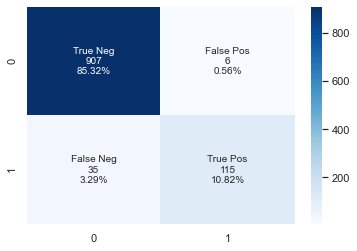

In [277]:
xgb_grid = xgb.XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.8, gamma=0.25, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learn_rate=0.1, learning_rate=0.300000012, max_delta_step=0,
              max_depth=4, min_child_weight=2, 
              monotone_constraints='()', n_estimators=100, n_jobs=-1,
              nthread=-1, num_parallel_tree=1, random_state=42, reg_alpha=0,
              reg_lambda=10.0, scale_pos_weight=1, seed=42, subsample=0.9,
              tree_method='exact', validate_parameters=1, verbosity=None)
evaluate_model(X_train, y_train, xgb_grid)

## 18.XGBoost with gridsearch CV-SMOTE

[18:36:12] WARNING: /Users/runner/miniforge3/conda-bld/xgboost_1593723618214/work/src/learner.cc:480: 
Parameters: { learn_rate } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[18:36:14] WARNING: /Users/runner/miniforge3/conda-bld/xgboost_1593723618214/work/src/learner.cc:480: 
Parameters: { learn_rate } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[18:36:15] WARNING: /Users/runner/miniforge3/conda-bld/xgboost_1593723618214/work/src/learner.cc:480: 
Parameters: { learn_rate } might not be used.

  This may not be accurate due to some parameters are only used in langu

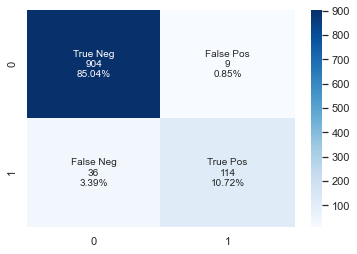

In [278]:
xgb_grid_SMOTE = xgb.XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.8, gamma=0.25, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learn_rate=0.1, learning_rate=0.300000012, max_delta_step=0,
              max_depth=4, min_child_weight=2, 
              monotone_constraints='()', n_estimators=100, n_jobs=-1,
              nthread=-1, num_parallel_tree=1, random_state=42, reg_alpha=0,
              reg_lambda=10.0, scale_pos_weight=1, seed=42, subsample=0.9,
              tree_method='exact', validate_parameters=1, verbosity=None)

evaluate_model(X_train_Smote,y_train_Smote,xgb_grid_SMOTE)  

##  XGboost - Optuna 

Code taken from https://github.com/optuna/optuna/blob/master/examples/xgboost_simple.py
Optuna  that optimizes a classifier configuration for Churn Dataset
using XGBoost.
In this example, we optimize the test accuracy of churn prediction
using XGBoost. We optimize both the choice of booster model and their hyper
parameters.

## 19.XGBoost using Optuna

Training Score:0.9836837150925636
Cross V Score: 0.9541878006967218 +/- 0.003121972055252944
Testing Score: 0.9595484477892756
Cross & Test Diff: -0.005360647092553794
Standard Deviations Away: -1.7170708121919662
Report:               precision    recall  f1-score   support

           0       0.96      0.99      0.98       913
           1       0.93      0.77      0.84       150

    accuracy                           0.96      1063
   macro avg       0.95      0.88      0.91      1063
weighted avg       0.96      0.96      0.96      1063

Accuracy Score: 0.9595484477892756


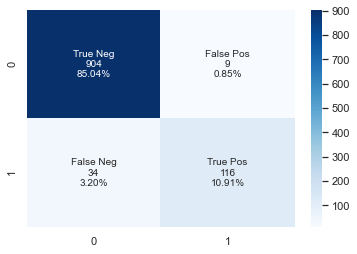

In [279]:

gbm_optuna = xgb.XGBClassifier(
    n_estimators = 200,
    learning_rate = 0.02,
    random_state =42,
    booster = 'dart',
    reg_lambda = 0.000537188870140782,
    alpha = 4.183769589573285e-07,
    max_depth = 8,
    eta = 0.1041103115293149,
    gamma = 0.009723248119317662,
    grow_policy = 'lossguide')

evaluate_model(X_train, y_train, gbm_optuna)

## 20.XGBoost using optuna - SMOTE

Training Score:0.9985396129974443
Cross V Score: 0.9558232931726908 +/- 0.02227389418425651
Testing Score: 0.9539040451552211
Cross & Test Diff: 0.0019192480174696769
Standard Deviations Away: 0.08616580475749173
Report:               precision    recall  f1-score   support

           0       0.97      0.98      0.97       913
           1       0.87      0.79      0.83       150

    accuracy                           0.95      1063
   macro avg       0.92      0.89      0.90      1063
weighted avg       0.95      0.95      0.95      1063

Accuracy Score: 0.9539040451552211


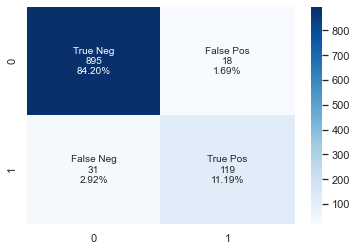

In [280]:
gbm_optuna_SMOTE = xgb.XGBClassifier(
    n_estimators = 630,
    learning_rate = 0.02,random_state =42,
    booster = 'dart',
    reg_lambda = 0.000537188870140782,
    alpha = 4.183769589573285e-07,
    max_depth = 8,
    eta = 0.1041103115293149,
    gamma = 0.009723248119317662,
    grow_policy = 'lossguide')

evaluate_model(X_train_Smote,y_train_Smote,gbm_optuna_SMOTE)

### Optimize hyperparameters of the model using Optuna with RandomForest 

The hyperparameters of the above algorithm are `n_estimators` and `max_depth` for which we can try different values to see if the model accuracy can be improved. The `objective` function is modified to accept a trial object. This trial has several methods for sampling hyperparameters. We create a study to run the hyperparameter optimization and finally read the best hyperparameters.

In [75]:
import optuna
import sklearn.svm
def objective(trial):

    classifier = trial.suggest_categorical('classifier', ['RandomForest', 'SVC',])
    
    if classifier == 'RandomForest':
        n_estimators = trial.suggest_int('n_estimators', 200, 2000,10)
        max_depth = int(trial.suggest_float('max_depth', 10, 100))
        #bootstrap = ('bootstrap',True, False)
        #max_feature = trial.suggest_int('max_features','auto', 'sqrt')
        #min_samples_leaf = trial.suggest_int('min_samples_leaf',1, 2, 4)
        #min_samples_split = trial.suggest_int('min_samples_split',2, 5, 10)
            
        clf = sklearn.ensemble.RandomForestClassifier(
              n_estimators=n_estimators, max_depth=max_depth)
    else:
        c = trial.suggest_float('svc_c', 1e-10, 1e100, log=True)
        
        clf = sklearn.svm.SVC(C=c, gamma='auto')

    return sklearn.model_selection.cross_val_score(
        clf,X_train,y_train, n_jobs=-1, cv=3).mean()



## 21.RandomForest - Optuna 

Training Score:1.0
Cross V Score: 0.940696272910824 +/- 0.0007913562248922901
Testing Score: 0.9510818438381938
Cross & Test Diff: -0.010385570927369803
Standard Deviations Away: -13.123762220715912
Report:               precision    recall  f1-score   support

           0       0.95      1.00      0.97       913
           1       0.99      0.66      0.79       150

    accuracy                           0.95      1063
   macro avg       0.97      0.83      0.88      1063
weighted avg       0.95      0.95      0.95      1063

Accuracy Score: 0.9510818438381938


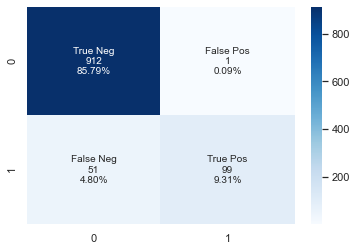

In [281]:
RFC_opt = RandomForestClassifier(n_estimators=630,max_depth = 48.857123929946525,random_state =42)
evaluate_model(X_train,y_train,RFC_opt)

## 22.RandomForest - Optuna-SMOTE

Training Score:1.0
Cross V Score: 0.9373859072654254 +/- 0.00787712632726961
Testing Score: 0.9444967074317968
Cross & Test Diff: -0.007110800166371445
Standard Deviations Away: -0.9027150093752792
Report:               precision    recall  f1-score   support

           0       0.97      0.97      0.97       913
           1       0.81      0.79      0.80       150

    accuracy                           0.94      1063
   macro avg       0.89      0.88      0.88      1063
weighted avg       0.94      0.94      0.94      1063

Accuracy Score: 0.9444967074317968


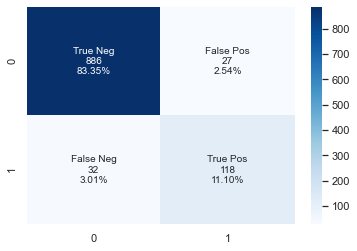

In [282]:
RFC_opt_SMOTE = RandomForestClassifier(n_estimators=630,max_depth = 48.857123929946525)
evaluate_model(X_train_Smote,y_train_Smote,RFC_opt_SMOTE)  

# Catboost is a gradient boosting library.




Gradient boosting works well with hetrogenouse data and gives best solution. 
Very easy to use relatively with small amount of data.It is an iterative algorithm.
Catboost - This algorithim supports categorical feature  without hyperparameter tuning and  gives us the good results.
we do not need to tune lot which saves more time.
Quality,speed in (training on cpu,gpu and also prediction speed)


## 23.CatBoostClassifier

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.0169
0:	learn: 0.6773818	total: 8.49ms	remaining: 8.48s
1:	learn: 0.6574818	total: 17.2ms	remaining: 8.6s
2:	learn: 0.6463191	total: 20.7ms	remaining: 6.89s
3:	learn: 0.6296048	total: 29.8ms	remaining: 7.43s
4:	learn: 0.6153819	total: 38ms	remaining: 7.55s
5:	learn: 0.6022667	total: 46.4ms	remaining: 7.68s
6:	learn: 0.5892902	total: 54.8ms	remaining: 7.77s
7:	learn: 0.5765804	total: 63ms	remaining: 7.82s
8:	learn: 0.5650728	total: 71.1ms	remaining: 7.83s
9:	learn: 0.5519057	total: 80.2ms	remaining: 7.93s
10:	learn: 0.5400911	total: 92.2ms	remaining: 8.29s
11:	learn: 0.5280835	total: 101ms	remaining: 8.29s
12:	learn: 0.5148092	total: 109ms	remaining: 8.3s
13:	learn: 0.5045136	total: 118ms	remaining: 8.28s
14:	learn: 0.4939231	total: 127ms	remaining: 8.36s
15:	learn: 0.4839564	total: 135ms	remaining: 8.33s
16:	learn: 0.4751055	total: 144ms	remaining: 8.32s
17:	learn: 0.4634526	total: 153ms	remaining: 8.33s
18:	learn: 0.4547272	total: 161ms	remaining: 8.3s
19:	learn

177:	learn: 0.1525204	total: 1.38s	remaining: 6.38s
178:	learn: 0.1521042	total: 1.39s	remaining: 6.37s
179:	learn: 0.1516198	total: 1.4s	remaining: 6.38s
180:	learn: 0.1514103	total: 1.41s	remaining: 6.37s
181:	learn: 0.1509308	total: 1.42s	remaining: 6.37s
182:	learn: 0.1504987	total: 1.42s	remaining: 6.36s
183:	learn: 0.1500853	total: 1.43s	remaining: 6.35s
184:	learn: 0.1497601	total: 1.44s	remaining: 6.33s
185:	learn: 0.1495125	total: 1.44s	remaining: 6.32s
186:	learn: 0.1493518	total: 1.45s	remaining: 6.31s
187:	learn: 0.1490552	total: 1.46s	remaining: 6.29s
188:	learn: 0.1488204	total: 1.46s	remaining: 6.27s
189:	learn: 0.1484355	total: 1.47s	remaining: 6.25s
190:	learn: 0.1480588	total: 1.47s	remaining: 6.23s
191:	learn: 0.1477994	total: 1.48s	remaining: 6.21s
192:	learn: 0.1475168	total: 1.48s	remaining: 6.19s
193:	learn: 0.1472075	total: 1.49s	remaining: 6.17s
194:	learn: 0.1467852	total: 1.49s	remaining: 6.15s
195:	learn: 0.1465978	total: 1.5s	remaining: 6.13s
196:	learn: 0.

345:	learn: 0.1197118	total: 2.36s	remaining: 4.46s
346:	learn: 0.1195612	total: 2.37s	remaining: 4.46s
347:	learn: 0.1194903	total: 2.38s	remaining: 4.45s
348:	learn: 0.1193913	total: 2.38s	remaining: 4.45s
349:	learn: 0.1192399	total: 2.39s	remaining: 4.45s
350:	learn: 0.1191298	total: 2.4s	remaining: 4.44s
351:	learn: 0.1190003	total: 2.41s	remaining: 4.44s
352:	learn: 0.1188594	total: 2.42s	remaining: 4.43s
353:	learn: 0.1187606	total: 2.42s	remaining: 4.42s
354:	learn: 0.1186516	total: 2.43s	remaining: 4.41s
355:	learn: 0.1185767	total: 2.43s	remaining: 4.4s
356:	learn: 0.1185211	total: 2.44s	remaining: 4.39s
357:	learn: 0.1184031	total: 2.44s	remaining: 4.38s
358:	learn: 0.1182320	total: 2.45s	remaining: 4.37s
359:	learn: 0.1181715	total: 2.45s	remaining: 4.36s
360:	learn: 0.1180676	total: 2.46s	remaining: 4.35s
361:	learn: 0.1179594	total: 2.46s	remaining: 4.34s
362:	learn: 0.1177828	total: 2.47s	remaining: 4.33s
363:	learn: 0.1176450	total: 2.47s	remaining: 4.32s
364:	learn: 0.

515:	learn: 0.1029870	total: 3.32s	remaining: 3.12s
516:	learn: 0.1029231	total: 3.33s	remaining: 3.11s
517:	learn: 0.1029018	total: 3.34s	remaining: 3.11s
518:	learn: 0.1027853	total: 3.35s	remaining: 3.1s
519:	learn: 0.1026854	total: 3.36s	remaining: 3.1s
520:	learn: 0.1025762	total: 3.37s	remaining: 3.1s
521:	learn: 0.1025476	total: 3.38s	remaining: 3.09s
522:	learn: 0.1024254	total: 3.38s	remaining: 3.08s
523:	learn: 0.1023875	total: 3.39s	remaining: 3.08s
524:	learn: 0.1022510	total: 3.4s	remaining: 3.08s
525:	learn: 0.1022049	total: 3.41s	remaining: 3.07s
526:	learn: 0.1021600	total: 3.42s	remaining: 3.07s
527:	learn: 0.1021280	total: 3.42s	remaining: 3.06s
528:	learn: 0.1020704	total: 3.43s	remaining: 3.06s
529:	learn: 0.1019962	total: 3.44s	remaining: 3.05s
530:	learn: 0.1018647	total: 3.44s	remaining: 3.04s
531:	learn: 0.1018108	total: 3.45s	remaining: 3.04s
532:	learn: 0.1017908	total: 3.46s	remaining: 3.03s
533:	learn: 0.1017802	total: 3.47s	remaining: 3.02s
534:	learn: 0.10

676:	learn: 0.0911222	total: 4.28s	remaining: 2.04s
677:	learn: 0.0910526	total: 4.29s	remaining: 2.04s
678:	learn: 0.0910025	total: 4.3s	remaining: 2.03s
679:	learn: 0.0909376	total: 4.31s	remaining: 2.03s
680:	learn: 0.0909125	total: 4.32s	remaining: 2.02s
681:	learn: 0.0908735	total: 4.33s	remaining: 2.02s
682:	learn: 0.0907368	total: 4.34s	remaining: 2.01s
683:	learn: 0.0907120	total: 4.34s	remaining: 2.01s
684:	learn: 0.0906519	total: 4.35s	remaining: 2s
685:	learn: 0.0905649	total: 4.36s	remaining: 1.99s
686:	learn: 0.0905459	total: 4.36s	remaining: 1.99s
687:	learn: 0.0903968	total: 4.37s	remaining: 1.98s
688:	learn: 0.0903216	total: 4.37s	remaining: 1.97s
689:	learn: 0.0902865	total: 4.38s	remaining: 1.97s
690:	learn: 0.0902476	total: 4.38s	remaining: 1.96s
691:	learn: 0.0901735	total: 4.38s	remaining: 1.95s
692:	learn: 0.0900878	total: 4.39s	remaining: 1.94s
693:	learn: 0.0900059	total: 4.39s	remaining: 1.94s
694:	learn: 0.0899635	total: 4.4s	remaining: 1.93s
695:	learn: 0.089

848:	learn: 0.0807155	total: 5.27s	remaining: 938ms
849:	learn: 0.0806770	total: 5.28s	remaining: 932ms
850:	learn: 0.0805797	total: 5.29s	remaining: 927ms
851:	learn: 0.0805284	total: 5.31s	remaining: 922ms
852:	learn: 0.0804917	total: 5.32s	remaining: 916ms
853:	learn: 0.0804544	total: 5.32s	remaining: 910ms
854:	learn: 0.0803658	total: 5.33s	remaining: 904ms
855:	learn: 0.0803053	total: 5.34s	remaining: 898ms
856:	learn: 0.0802690	total: 5.34s	remaining: 892ms
857:	learn: 0.0802429	total: 5.35s	remaining: 885ms
858:	learn: 0.0801923	total: 5.35s	remaining: 879ms
859:	learn: 0.0801374	total: 5.36s	remaining: 872ms
860:	learn: 0.0801117	total: 5.36s	remaining: 866ms
861:	learn: 0.0800697	total: 5.37s	remaining: 859ms
862:	learn: 0.0800278	total: 5.37s	remaining: 853ms
863:	learn: 0.0799555	total: 5.38s	remaining: 847ms
864:	learn: 0.0799116	total: 5.38s	remaining: 840ms
865:	learn: 0.0798723	total: 5.39s	remaining: 834ms
866:	learn: 0.0797980	total: 5.39s	remaining: 827ms
867:	learn: 

43:	learn: 0.3475807	total: 220ms	remaining: 4.78s
44:	learn: 0.3420701	total: 227ms	remaining: 4.82s
45:	learn: 0.3380956	total: 234ms	remaining: 4.85s
46:	learn: 0.3334262	total: 241ms	remaining: 4.89s
47:	learn: 0.3306910	total: 248ms	remaining: 4.92s
48:	learn: 0.3270365	total: 255ms	remaining: 4.95s
49:	learn: 0.3225222	total: 262ms	remaining: 4.97s
50:	learn: 0.3197335	total: 269ms	remaining: 5.01s
51:	learn: 0.3163851	total: 274ms	remaining: 4.99s
52:	learn: 0.3134133	total: 278ms	remaining: 4.97s
53:	learn: 0.3108461	total: 284ms	remaining: 4.98s
54:	learn: 0.3062629	total: 290ms	remaining: 4.98s
55:	learn: 0.3029399	total: 295ms	remaining: 4.98s
56:	learn: 0.2997120	total: 300ms	remaining: 4.96s
57:	learn: 0.2966536	total: 305ms	remaining: 4.96s
58:	learn: 0.2944711	total: 310ms	remaining: 4.95s
59:	learn: 0.2915178	total: 314ms	remaining: 4.92s
60:	learn: 0.2889117	total: 319ms	remaining: 4.91s
61:	learn: 0.2858920	total: 323ms	remaining: 4.89s
62:	learn: 0.2831975	total: 327

230:	learn: 0.1475553	total: 1.17s	remaining: 3.9s
231:	learn: 0.1473261	total: 1.18s	remaining: 3.9s
232:	learn: 0.1470729	total: 1.19s	remaining: 3.91s
233:	learn: 0.1466191	total: 1.19s	remaining: 3.91s
234:	learn: 0.1463023	total: 1.2s	remaining: 3.91s
235:	learn: 0.1460660	total: 1.21s	remaining: 3.91s
236:	learn: 0.1457004	total: 1.22s	remaining: 3.91s
237:	learn: 0.1454602	total: 1.22s	remaining: 3.91s
238:	learn: 0.1452298	total: 1.23s	remaining: 3.91s
239:	learn: 0.1450060	total: 1.23s	remaining: 3.91s
240:	learn: 0.1447167	total: 1.24s	remaining: 3.91s
241:	learn: 0.1445283	total: 1.24s	remaining: 3.9s
242:	learn: 0.1443507	total: 1.25s	remaining: 3.89s
243:	learn: 0.1441927	total: 1.25s	remaining: 3.88s
244:	learn: 0.1440349	total: 1.26s	remaining: 3.88s
245:	learn: 0.1437337	total: 1.26s	remaining: 3.87s
246:	learn: 0.1434732	total: 1.27s	remaining: 3.86s
247:	learn: 0.1432517	total: 1.27s	remaining: 3.85s
248:	learn: 0.1430018	total: 1.27s	remaining: 3.85s
249:	learn: 0.14

418:	learn: 0.1136093	total: 2.13s	remaining: 2.95s
419:	learn: 0.1133932	total: 2.13s	remaining: 2.95s
420:	learn: 0.1132675	total: 2.14s	remaining: 2.94s
421:	learn: 0.1131443	total: 2.15s	remaining: 2.94s
422:	learn: 0.1130394	total: 2.16s	remaining: 2.94s
423:	learn: 0.1129132	total: 2.17s	remaining: 2.95s
424:	learn: 0.1128076	total: 2.17s	remaining: 2.94s
425:	learn: 0.1126495	total: 2.18s	remaining: 2.94s
426:	learn: 0.1124871	total: 2.19s	remaining: 2.93s
427:	learn: 0.1123463	total: 2.19s	remaining: 2.93s
428:	learn: 0.1122579	total: 2.2s	remaining: 2.92s
429:	learn: 0.1121825	total: 2.2s	remaining: 2.92s
430:	learn: 0.1120250	total: 2.21s	remaining: 2.92s
431:	learn: 0.1119448	total: 2.21s	remaining: 2.91s
432:	learn: 0.1117655	total: 2.22s	remaining: 2.9s
433:	learn: 0.1117220	total: 2.22s	remaining: 2.9s
434:	learn: 0.1115945	total: 2.23s	remaining: 2.89s
435:	learn: 0.1115119	total: 2.23s	remaining: 2.88s
436:	learn: 0.1113719	total: 2.23s	remaining: 2.88s
437:	learn: 0.11

609:	learn: 0.0946485	total: 3.09s	remaining: 1.98s
610:	learn: 0.0944879	total: 3.1s	remaining: 1.98s
611:	learn: 0.0944299	total: 3.11s	remaining: 1.97s
612:	learn: 0.0942860	total: 3.12s	remaining: 1.97s
613:	learn: 0.0942342	total: 3.13s	remaining: 1.96s
614:	learn: 0.0942049	total: 3.13s	remaining: 1.96s
615:	learn: 0.0940881	total: 3.14s	remaining: 1.96s
616:	learn: 0.0940158	total: 3.15s	remaining: 1.95s
617:	learn: 0.0939807	total: 3.15s	remaining: 1.95s
618:	learn: 0.0938302	total: 3.15s	remaining: 1.94s
619:	learn: 0.0937503	total: 3.16s	remaining: 1.94s
620:	learn: 0.0936964	total: 3.17s	remaining: 1.93s
621:	learn: 0.0935574	total: 3.17s	remaining: 1.93s
622:	learn: 0.0934458	total: 3.17s	remaining: 1.92s
623:	learn: 0.0934016	total: 3.18s	remaining: 1.92s
624:	learn: 0.0932482	total: 3.18s	remaining: 1.91s
625:	learn: 0.0931979	total: 3.19s	remaining: 1.91s
626:	learn: 0.0931596	total: 3.19s	remaining: 1.9s
627:	learn: 0.0930595	total: 3.2s	remaining: 1.89s
628:	learn: 0.0

799:	learn: 0.0800206	total: 4.05s	remaining: 1.01s
800:	learn: 0.0799015	total: 4.06s	remaining: 1.01s
801:	learn: 0.0798731	total: 4.07s	remaining: 1s
802:	learn: 0.0797863	total: 4.07s	remaining: 1000ms
803:	learn: 0.0797552	total: 4.08s	remaining: 995ms
804:	learn: 0.0796595	total: 4.09s	remaining: 991ms
805:	learn: 0.0795608	total: 4.1s	remaining: 986ms
806:	learn: 0.0795029	total: 4.11s	remaining: 982ms
807:	learn: 0.0794235	total: 4.11s	remaining: 977ms
808:	learn: 0.0793321	total: 4.11s	remaining: 971ms
809:	learn: 0.0792833	total: 4.12s	remaining: 966ms
810:	learn: 0.0791979	total: 4.12s	remaining: 961ms
811:	learn: 0.0791636	total: 4.13s	remaining: 956ms
812:	learn: 0.0791116	total: 4.14s	remaining: 951ms
813:	learn: 0.0790521	total: 4.14s	remaining: 946ms
814:	learn: 0.0789961	total: 4.14s	remaining: 941ms
815:	learn: 0.0789217	total: 4.15s	remaining: 936ms
816:	learn: 0.0788843	total: 4.15s	remaining: 930ms
817:	learn: 0.0788389	total: 4.16s	remaining: 925ms
818:	learn: 0.0

988:	learn: 0.0682318	total: 5.01s	remaining: 55.8ms
989:	learn: 0.0681642	total: 5.02s	remaining: 50.7ms
990:	learn: 0.0681326	total: 5.03s	remaining: 45.7ms
991:	learn: 0.0680333	total: 5.03s	remaining: 40.6ms
992:	learn: 0.0679997	total: 5.04s	remaining: 35.5ms
993:	learn: 0.0679767	total: 5.05s	remaining: 30.5ms
994:	learn: 0.0678912	total: 5.06s	remaining: 25.4ms
995:	learn: 0.0678496	total: 5.06s	remaining: 20.3ms
996:	learn: 0.0678179	total: 5.07s	remaining: 15.2ms
997:	learn: 0.0677698	total: 5.07s	remaining: 10.2ms
998:	learn: 0.0677439	total: 5.08s	remaining: 5.08ms
999:	learn: 0.0676722	total: 5.08s	remaining: 0us
Learning rate set to 0.014214
0:	learn: 0.6789198	total: 4.21ms	remaining: 4.21s
1:	learn: 0.6683059	total: 8.44ms	remaining: 4.21s
2:	learn: 0.6586680	total: 10.6ms	remaining: 3.51s
3:	learn: 0.6483357	total: 15ms	remaining: 3.73s
4:	learn: 0.6342277	total: 19.2ms	remaining: 3.82s
5:	learn: 0.6211849	total: 23.3ms	remaining: 3.87s
6:	learn: 0.6057261	total: 27.8ms

163:	learn: 0.1637460	total: 825ms	remaining: 4.2s
164:	learn: 0.1634797	total: 833ms	remaining: 4.22s
165:	learn: 0.1628373	total: 841ms	remaining: 4.22s
166:	learn: 0.1624602	total: 849ms	remaining: 4.23s
167:	learn: 0.1620357	total: 858ms	remaining: 4.25s
168:	learn: 0.1614623	total: 865ms	remaining: 4.25s
169:	learn: 0.1610283	total: 872ms	remaining: 4.26s
170:	learn: 0.1607380	total: 879ms	remaining: 4.26s
171:	learn: 0.1603809	total: 884ms	remaining: 4.25s
172:	learn: 0.1600734	total: 889ms	remaining: 4.25s
173:	learn: 0.1596377	total: 893ms	remaining: 4.24s
174:	learn: 0.1590567	total: 899ms	remaining: 4.24s
175:	learn: 0.1586657	total: 905ms	remaining: 4.24s
176:	learn: 0.1582989	total: 911ms	remaining: 4.23s
177:	learn: 0.1578505	total: 915ms	remaining: 4.22s
178:	learn: 0.1575231	total: 919ms	remaining: 4.22s
179:	learn: 0.1570570	total: 924ms	remaining: 4.21s
180:	learn: 0.1566469	total: 929ms	remaining: 4.2s
181:	learn: 0.1563542	total: 933ms	remaining: 4.19s
182:	learn: 0.

350:	learn: 0.1191982	total: 1.78s	remaining: 3.28s
351:	learn: 0.1190371	total: 1.78s	remaining: 3.28s
352:	learn: 0.1189447	total: 1.79s	remaining: 3.28s
353:	learn: 0.1187820	total: 1.8s	remaining: 3.28s
354:	learn: 0.1186960	total: 1.8s	remaining: 3.28s
355:	learn: 0.1186227	total: 1.81s	remaining: 3.28s
356:	learn: 0.1184318	total: 1.82s	remaining: 3.28s
357:	learn: 0.1182830	total: 1.83s	remaining: 3.28s
358:	learn: 0.1181122	total: 1.83s	remaining: 3.27s
359:	learn: 0.1179982	total: 1.84s	remaining: 3.27s
360:	learn: 0.1178585	total: 1.84s	remaining: 3.26s
361:	learn: 0.1176782	total: 1.85s	remaining: 3.26s
362:	learn: 0.1176074	total: 1.85s	remaining: 3.25s
363:	learn: 0.1175821	total: 1.86s	remaining: 3.25s
364:	learn: 0.1174803	total: 1.86s	remaining: 3.24s
365:	learn: 0.1173042	total: 1.87s	remaining: 3.23s
366:	learn: 0.1171678	total: 1.87s	remaining: 3.23s
367:	learn: 0.1170401	total: 1.88s	remaining: 3.22s
368:	learn: 0.1169423	total: 1.88s	remaining: 3.21s
369:	learn: 0.

538:	learn: 0.0988208	total: 2.74s	remaining: 2.34s
539:	learn: 0.0988127	total: 2.75s	remaining: 2.34s
540:	learn: 0.0986819	total: 2.75s	remaining: 2.34s
541:	learn: 0.0986259	total: 2.76s	remaining: 2.33s
542:	learn: 0.0984573	total: 2.77s	remaining: 2.33s
543:	learn: 0.0984197	total: 2.78s	remaining: 2.33s
544:	learn: 0.0982911	total: 2.78s	remaining: 2.32s
545:	learn: 0.0981063	total: 2.79s	remaining: 2.32s
546:	learn: 0.0980440	total: 2.79s	remaining: 2.31s
547:	learn: 0.0979816	total: 2.8s	remaining: 2.31s
548:	learn: 0.0979378	total: 2.81s	remaining: 2.31s
549:	learn: 0.0979082	total: 2.81s	remaining: 2.3s
550:	learn: 0.0977660	total: 2.82s	remaining: 2.3s
551:	learn: 0.0977110	total: 2.82s	remaining: 2.29s
552:	learn: 0.0975898	total: 2.83s	remaining: 2.28s
553:	learn: 0.0975099	total: 2.83s	remaining: 2.28s
554:	learn: 0.0974868	total: 2.83s	remaining: 2.27s
555:	learn: 0.0974216	total: 2.84s	remaining: 2.27s
556:	learn: 0.0973528	total: 2.84s	remaining: 2.26s
557:	learn: 0.0

727:	learn: 0.0839055	total: 3.7s	remaining: 1.38s
728:	learn: 0.0837937	total: 3.71s	remaining: 1.38s
729:	learn: 0.0836200	total: 3.72s	remaining: 1.38s
730:	learn: 0.0835960	total: 3.73s	remaining: 1.37s
731:	learn: 0.0835569	total: 3.73s	remaining: 1.37s
732:	learn: 0.0835237	total: 3.74s	remaining: 1.36s
733:	learn: 0.0834126	total: 3.75s	remaining: 1.36s
734:	learn: 0.0833809	total: 3.75s	remaining: 1.35s
735:	learn: 0.0832587	total: 3.76s	remaining: 1.35s
736:	learn: 0.0830903	total: 3.76s	remaining: 1.34s
737:	learn: 0.0830442	total: 3.77s	remaining: 1.34s
738:	learn: 0.0829957	total: 3.78s	remaining: 1.33s
739:	learn: 0.0829361	total: 3.78s	remaining: 1.33s
740:	learn: 0.0828878	total: 3.79s	remaining: 1.32s
741:	learn: 0.0828015	total: 3.79s	remaining: 1.32s
742:	learn: 0.0826691	total: 3.79s	remaining: 1.31s
743:	learn: 0.0825231	total: 3.8s	remaining: 1.31s
744:	learn: 0.0824053	total: 3.8s	remaining: 1.3s
745:	learn: 0.0822426	total: 3.81s	remaining: 1.3s
746:	learn: 0.082

916:	learn: 0.0714607	total: 4.67s	remaining: 423ms
917:	learn: 0.0714179	total: 4.68s	remaining: 418ms
918:	learn: 0.0713839	total: 4.68s	remaining: 413ms
919:	learn: 0.0713192	total: 4.69s	remaining: 408ms
920:	learn: 0.0712176	total: 4.7s	remaining: 403ms
921:	learn: 0.0711860	total: 4.7s	remaining: 398ms
922:	learn: 0.0711521	total: 4.71s	remaining: 393ms
923:	learn: 0.0711214	total: 4.72s	remaining: 388ms
924:	learn: 0.0710967	total: 4.72s	remaining: 383ms
925:	learn: 0.0710642	total: 4.73s	remaining: 378ms
926:	learn: 0.0709701	total: 4.73s	remaining: 373ms
927:	learn: 0.0709281	total: 4.74s	remaining: 368ms
928:	learn: 0.0708948	total: 4.74s	remaining: 363ms
929:	learn: 0.0708740	total: 4.75s	remaining: 357ms
930:	learn: 0.0708450	total: 4.75s	remaining: 352ms
931:	learn: 0.0708030	total: 4.76s	remaining: 347ms
932:	learn: 0.0707097	total: 4.76s	remaining: 342ms
933:	learn: 0.0706632	total: 4.77s	remaining: 337ms
934:	learn: 0.0705845	total: 4.77s	remaining: 332ms
935:	learn: 0.

86:	learn: 0.2380328	total: 427ms	remaining: 4.48s
87:	learn: 0.2364771	total: 435ms	remaining: 4.51s
88:	learn: 0.2348335	total: 442ms	remaining: 4.52s
89:	learn: 0.2335933	total: 448ms	remaining: 4.53s
90:	learn: 0.2322613	total: 455ms	remaining: 4.55s
91:	learn: 0.2310942	total: 462ms	remaining: 4.56s
92:	learn: 0.2295886	total: 470ms	remaining: 4.58s
93:	learn: 0.2282332	total: 477ms	remaining: 4.6s
94:	learn: 0.2267233	total: 482ms	remaining: 4.59s
95:	learn: 0.2254322	total: 487ms	remaining: 4.58s
96:	learn: 0.2237716	total: 491ms	remaining: 4.57s
97:	learn: 0.2223189	total: 497ms	remaining: 4.57s
98:	learn: 0.2211826	total: 503ms	remaining: 4.58s
99:	learn: 0.2199070	total: 509ms	remaining: 4.58s
100:	learn: 0.2187601	total: 514ms	remaining: 4.57s
101:	learn: 0.2176935	total: 518ms	remaining: 4.56s
102:	learn: 0.2162661	total: 522ms	remaining: 4.55s
103:	learn: 0.2150980	total: 527ms	remaining: 4.54s
104:	learn: 0.2140435	total: 531ms	remaining: 4.53s
105:	learn: 0.2129293	total

278:	learn: 0.1335740	total: 1.39s	remaining: 3.59s
279:	learn: 0.1333498	total: 1.4s	remaining: 3.6s
280:	learn: 0.1330256	total: 1.41s	remaining: 3.6s
281:	learn: 0.1328641	total: 1.41s	remaining: 3.6s
282:	learn: 0.1327023	total: 1.42s	remaining: 3.6s
283:	learn: 0.1324586	total: 1.43s	remaining: 3.6s
284:	learn: 0.1322463	total: 1.43s	remaining: 3.6s
285:	learn: 0.1320486	total: 1.44s	remaining: 3.6s
286:	learn: 0.1319842	total: 1.45s	remaining: 3.6s
287:	learn: 0.1317745	total: 1.45s	remaining: 3.59s
288:	learn: 0.1315473	total: 1.46s	remaining: 3.58s
289:	learn: 0.1313004	total: 1.46s	remaining: 3.58s
290:	learn: 0.1311064	total: 1.47s	remaining: 3.58s
291:	learn: 0.1308848	total: 1.47s	remaining: 3.57s
292:	learn: 0.1305961	total: 1.48s	remaining: 3.56s
293:	learn: 0.1304457	total: 1.48s	remaining: 3.56s
294:	learn: 0.1303742	total: 1.49s	remaining: 3.55s
295:	learn: 0.1301534	total: 1.49s	remaining: 3.54s
296:	learn: 0.1299543	total: 1.49s	remaining: 3.54s
297:	learn: 0.1298771

467:	learn: 0.1080935	total: 2.34s	remaining: 2.66s
468:	learn: 0.1079581	total: 2.35s	remaining: 2.66s
469:	learn: 0.1078458	total: 2.35s	remaining: 2.65s
470:	learn: 0.1076962	total: 2.36s	remaining: 2.65s
471:	learn: 0.1075966	total: 2.37s	remaining: 2.65s
472:	learn: 0.1074831	total: 2.37s	remaining: 2.64s
473:	learn: 0.1074096	total: 2.38s	remaining: 2.64s
474:	learn: 0.1072772	total: 2.39s	remaining: 2.64s
475:	learn: 0.1072323	total: 2.4s	remaining: 2.64s
476:	learn: 0.1070439	total: 2.4s	remaining: 2.63s
477:	learn: 0.1069469	total: 2.41s	remaining: 2.63s
478:	learn: 0.1068738	total: 2.41s	remaining: 2.63s
479:	learn: 0.1067715	total: 2.42s	remaining: 2.62s
480:	learn: 0.1067203	total: 2.42s	remaining: 2.61s
481:	learn: 0.1065331	total: 2.43s	remaining: 2.61s
482:	learn: 0.1064004	total: 2.43s	remaining: 2.6s
483:	learn: 0.1063177	total: 2.44s	remaining: 2.6s
484:	learn: 0.1062484	total: 2.44s	remaining: 2.59s
485:	learn: 0.1061729	total: 2.44s	remaining: 2.58s
486:	learn: 0.10

655:	learn: 0.0920168	total: 3.3s	remaining: 1.73s
656:	learn: 0.0919325	total: 3.31s	remaining: 1.73s
657:	learn: 0.0917916	total: 3.32s	remaining: 1.73s
658:	learn: 0.0917407	total: 3.33s	remaining: 1.72s
659:	learn: 0.0915548	total: 3.33s	remaining: 1.72s
660:	learn: 0.0915016	total: 3.34s	remaining: 1.71s
661:	learn: 0.0913946	total: 3.35s	remaining: 1.71s
662:	learn: 0.0913250	total: 3.36s	remaining: 1.71s
663:	learn: 0.0912668	total: 3.37s	remaining: 1.7s
664:	learn: 0.0910812	total: 3.37s	remaining: 1.7s
665:	learn: 0.0909984	total: 3.38s	remaining: 1.69s
666:	learn: 0.0908576	total: 3.38s	remaining: 1.69s
667:	learn: 0.0907908	total: 3.39s	remaining: 1.68s
668:	learn: 0.0906248	total: 3.39s	remaining: 1.68s
669:	learn: 0.0905885	total: 3.4s	remaining: 1.67s
670:	learn: 0.0905373	total: 3.4s	remaining: 1.67s
671:	learn: 0.0904958	total: 3.4s	remaining: 1.66s
672:	learn: 0.0904035	total: 3.41s	remaining: 1.66s
673:	learn: 0.0903718	total: 3.41s	remaining: 1.65s
674:	learn: 0.0903

846:	learn: 0.0771802	total: 4.27s	remaining: 771ms
847:	learn: 0.0771566	total: 4.28s	remaining: 767ms
848:	learn: 0.0770434	total: 4.28s	remaining: 762ms
849:	learn: 0.0770049	total: 4.29s	remaining: 757ms
850:	learn: 0.0769798	total: 4.3s	remaining: 753ms
851:	learn: 0.0768325	total: 4.3s	remaining: 748ms
852:	learn: 0.0767895	total: 4.31s	remaining: 743ms
853:	learn: 0.0766679	total: 4.32s	remaining: 739ms
854:	learn: 0.0766204	total: 4.33s	remaining: 734ms
855:	learn: 0.0765791	total: 4.33s	remaining: 729ms
856:	learn: 0.0765368	total: 4.34s	remaining: 724ms
857:	learn: 0.0764966	total: 4.34s	remaining: 719ms
858:	learn: 0.0764545	total: 4.35s	remaining: 714ms
859:	learn: 0.0764153	total: 4.35s	remaining: 709ms
860:	learn: 0.0763955	total: 4.36s	remaining: 704ms
861:	learn: 0.0763512	total: 4.36s	remaining: 698ms
862:	learn: 0.0762943	total: 4.37s	remaining: 693ms
863:	learn: 0.0762543	total: 4.37s	remaining: 688ms
864:	learn: 0.0761927	total: 4.37s	remaining: 683ms
865:	learn: 0.

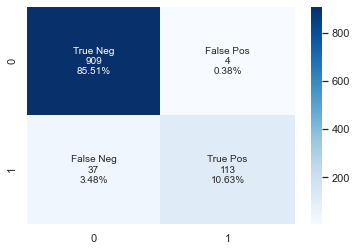

In [283]:
from catboost import CatBoostClassifier
Cat_model1 = CatBoostClassifier()
    
#     use_best_model=False

Cat_model1.fit(
    X_train, y_train,
    #cat_features=cat_features,
    eval_set=(X_test, y_test),
    verbose=False,
    plot=True
)
evaluate_model(X_train,y_train,Cat_model1) 

## 24.CatBoostClassifier - SMOTE

Learning rate set to 0.021297
0:	learn: 0.6797948	total: 12.7ms	remaining: 12.7s
1:	learn: 0.6680313	total: 24.1ms	remaining: 12s
2:	learn: 0.6548225	total: 35.3ms	remaining: 11.7s
3:	learn: 0.6424256	total: 46.3ms	remaining: 11.5s
4:	learn: 0.6313855	total: 57.4ms	remaining: 11.4s
5:	learn: 0.6213605	total: 68.4ms	remaining: 11.3s
6:	learn: 0.6105664	total: 79.4ms	remaining: 11.3s
7:	learn: 0.6016493	total: 89.8ms	remaining: 11.1s
8:	learn: 0.5930444	total: 101ms	remaining: 11.1s
9:	learn: 0.5828901	total: 112ms	remaining: 11.1s
10:	learn: 0.5756011	total: 123ms	remaining: 11.1s
11:	learn: 0.5677550	total: 135ms	remaining: 11.1s
12:	learn: 0.5612394	total: 146ms	remaining: 11.1s
13:	learn: 0.5527311	total: 157ms	remaining: 11s
14:	learn: 0.5462361	total: 172ms	remaining: 11.3s
15:	learn: 0.5395003	total: 183ms	remaining: 11.3s
16:	learn: 0.5330486	total: 199ms	remaining: 11.5s
17:	learn: 0.5248461	total: 211ms	remaining: 11.5s
18:	learn: 0.5180490	total: 222ms	remaining: 11.5s
19:	lea

181:	learn: 0.2026493	total: 2.05s	remaining: 9.22s
182:	learn: 0.2018239	total: 2.06s	remaining: 9.21s
183:	learn: 0.2011085	total: 2.07s	remaining: 9.2s
184:	learn: 0.1998833	total: 2.08s	remaining: 9.19s
185:	learn: 0.1995858	total: 2.1s	remaining: 9.18s
186:	learn: 0.1991978	total: 2.1s	remaining: 9.15s
187:	learn: 0.1981148	total: 2.11s	remaining: 9.12s
188:	learn: 0.1977819	total: 2.12s	remaining: 9.1s
189:	learn: 0.1969925	total: 2.13s	remaining: 9.08s
190:	learn: 0.1965097	total: 2.13s	remaining: 9.04s
191:	learn: 0.1960894	total: 2.14s	remaining: 9.02s
192:	learn: 0.1958210	total: 2.15s	remaining: 8.98s
193:	learn: 0.1951364	total: 2.15s	remaining: 8.96s
194:	learn: 0.1948385	total: 2.16s	remaining: 8.93s
195:	learn: 0.1945917	total: 2.17s	remaining: 8.9s
196:	learn: 0.1942858	total: 2.17s	remaining: 8.87s
197:	learn: 0.1930486	total: 2.19s	remaining: 8.85s
198:	learn: 0.1927330	total: 2.19s	remaining: 8.83s
199:	learn: 0.1924458	total: 2.2s	remaining: 8.8s
200:	learn: 0.19219

358:	learn: 0.1412366	total: 3.44s	remaining: 6.14s
359:	learn: 0.1411382	total: 3.45s	remaining: 6.14s
360:	learn: 0.1409284	total: 3.46s	remaining: 6.13s
361:	learn: 0.1406777	total: 3.47s	remaining: 6.12s
362:	learn: 0.1405518	total: 3.48s	remaining: 6.12s
363:	learn: 0.1404291	total: 3.5s	remaining: 6.11s
364:	learn: 0.1402479	total: 3.5s	remaining: 6.09s
365:	learn: 0.1400506	total: 3.51s	remaining: 6.08s
366:	learn: 0.1399513	total: 3.52s	remaining: 6.07s
367:	learn: 0.1394443	total: 3.53s	remaining: 6.06s
368:	learn: 0.1392697	total: 3.53s	remaining: 6.04s
369:	learn: 0.1390881	total: 3.54s	remaining: 6.03s
370:	learn: 0.1387327	total: 3.55s	remaining: 6.01s
371:	learn: 0.1386292	total: 3.55s	remaining: 6s
372:	learn: 0.1382724	total: 3.56s	remaining: 5.98s
373:	learn: 0.1380487	total: 3.57s	remaining: 5.97s
374:	learn: 0.1378789	total: 3.57s	remaining: 5.96s
375:	learn: 0.1376630	total: 3.58s	remaining: 5.94s
376:	learn: 0.1374692	total: 3.59s	remaining: 5.93s
377:	learn: 0.137

537:	learn: 0.1025871	total: 4.84s	remaining: 4.15s
538:	learn: 0.1025088	total: 4.85s	remaining: 4.14s
539:	learn: 0.1024038	total: 4.86s	remaining: 4.14s
540:	learn: 0.1022990	total: 4.87s	remaining: 4.13s
541:	learn: 0.1020364	total: 4.88s	remaining: 4.12s
542:	learn: 0.1015891	total: 4.89s	remaining: 4.12s
543:	learn: 0.1014697	total: 4.9s	remaining: 4.11s
544:	learn: 0.1013195	total: 4.91s	remaining: 4.09s
545:	learn: 0.1011431	total: 4.92s	remaining: 4.09s
546:	learn: 0.1010698	total: 4.92s	remaining: 4.08s
547:	learn: 0.1010006	total: 4.93s	remaining: 4.07s
548:	learn: 0.1008705	total: 4.94s	remaining: 4.05s
549:	learn: 0.1006354	total: 4.94s	remaining: 4.04s
550:	learn: 0.1003778	total: 4.95s	remaining: 4.03s
551:	learn: 0.1002502	total: 4.96s	remaining: 4.02s
552:	learn: 0.1001329	total: 4.96s	remaining: 4.01s
553:	learn: 0.0999522	total: 4.97s	remaining: 4s
554:	learn: 0.0997925	total: 4.98s	remaining: 3.99s
555:	learn: 0.0996759	total: 4.98s	remaining: 3.98s
556:	learn: 0.09

719:	learn: 0.0809074	total: 6.25s	remaining: 2.43s
720:	learn: 0.0807406	total: 6.26s	remaining: 2.42s
721:	learn: 0.0807062	total: 6.27s	remaining: 2.41s
722:	learn: 0.0805890	total: 6.28s	remaining: 2.41s
723:	learn: 0.0805587	total: 6.29s	remaining: 2.4s
724:	learn: 0.0804899	total: 6.3s	remaining: 2.39s
725:	learn: 0.0804240	total: 6.31s	remaining: 2.38s
726:	learn: 0.0803482	total: 6.32s	remaining: 2.37s
727:	learn: 0.0803042	total: 6.33s	remaining: 2.36s
728:	learn: 0.0802264	total: 6.33s	remaining: 2.35s
729:	learn: 0.0801982	total: 6.34s	remaining: 2.34s
730:	learn: 0.0801477	total: 6.34s	remaining: 2.33s
731:	learn: 0.0801158	total: 6.35s	remaining: 2.33s
732:	learn: 0.0800432	total: 6.36s	remaining: 2.31s
733:	learn: 0.0799884	total: 6.36s	remaining: 2.31s
734:	learn: 0.0799268	total: 6.37s	remaining: 2.3s
735:	learn: 0.0798218	total: 6.38s	remaining: 2.29s
736:	learn: 0.0797321	total: 6.38s	remaining: 2.28s
737:	learn: 0.0796825	total: 6.39s	remaining: 2.27s
738:	learn: 0.0

900:	learn: 0.0678757	total: 7.63s	remaining: 839ms
901:	learn: 0.0678642	total: 7.65s	remaining: 831ms
902:	learn: 0.0678463	total: 7.66s	remaining: 823ms
903:	learn: 0.0677918	total: 7.67s	remaining: 815ms
904:	learn: 0.0677339	total: 7.68s	remaining: 806ms
905:	learn: 0.0676337	total: 7.69s	remaining: 798ms
906:	learn: 0.0675666	total: 7.7s	remaining: 790ms
907:	learn: 0.0675446	total: 7.71s	remaining: 781ms
908:	learn: 0.0674855	total: 7.72s	remaining: 773ms
909:	learn: 0.0674147	total: 7.72s	remaining: 764ms
910:	learn: 0.0673437	total: 7.73s	remaining: 755ms
911:	learn: 0.0672590	total: 7.74s	remaining: 747ms
912:	learn: 0.0671460	total: 7.74s	remaining: 738ms
913:	learn: 0.0670650	total: 7.75s	remaining: 729ms
914:	learn: 0.0670419	total: 7.76s	remaining: 721ms
915:	learn: 0.0670186	total: 7.76s	remaining: 712ms
916:	learn: 0.0669726	total: 7.77s	remaining: 703ms
917:	learn: 0.0669571	total: 7.78s	remaining: 695ms
918:	learn: 0.0668517	total: 7.78s	remaining: 686ms
919:	learn: 0

86:	learn: 0.2813599	total: 589ms	remaining: 6.18s
87:	learn: 0.2785484	total: 599ms	remaining: 6.21s
88:	learn: 0.2771666	total: 608ms	remaining: 6.22s
89:	learn: 0.2751640	total: 619ms	remaining: 6.25s
90:	learn: 0.2745399	total: 628ms	remaining: 6.28s
91:	learn: 0.2720719	total: 638ms	remaining: 6.29s
92:	learn: 0.2700365	total: 644ms	remaining: 6.28s
93:	learn: 0.2689840	total: 652ms	remaining: 6.28s
94:	learn: 0.2664922	total: 659ms	remaining: 6.28s
95:	learn: 0.2641086	total: 665ms	remaining: 6.27s
96:	learn: 0.2626636	total: 671ms	remaining: 6.25s
97:	learn: 0.2612801	total: 678ms	remaining: 6.24s
98:	learn: 0.2598318	total: 684ms	remaining: 6.22s
99:	learn: 0.2579523	total: 690ms	remaining: 6.21s
100:	learn: 0.2562489	total: 695ms	remaining: 6.19s
101:	learn: 0.2550626	total: 701ms	remaining: 6.17s
102:	learn: 0.2541860	total: 707ms	remaining: 6.16s
103:	learn: 0.2529890	total: 713ms	remaining: 6.14s
104:	learn: 0.2522209	total: 719ms	remaining: 6.13s
105:	learn: 0.2504706	tota

253:	learn: 0.1485230	total: 1.77s	remaining: 5.19s
254:	learn: 0.1481895	total: 1.78s	remaining: 5.19s
255:	learn: 0.1480327	total: 1.79s	remaining: 5.19s
256:	learn: 0.1475892	total: 1.8s	remaining: 5.2s
257:	learn: 0.1474208	total: 1.81s	remaining: 5.2s
258:	learn: 0.1466903	total: 1.82s	remaining: 5.2s
259:	learn: 0.1464855	total: 1.82s	remaining: 5.19s
260:	learn: 0.1463237	total: 1.83s	remaining: 5.19s
261:	learn: 0.1461207	total: 1.84s	remaining: 5.18s
262:	learn: 0.1455668	total: 1.85s	remaining: 5.18s
263:	learn: 0.1453443	total: 1.85s	remaining: 5.17s
264:	learn: 0.1451515	total: 1.86s	remaining: 5.16s
265:	learn: 0.1447898	total: 1.86s	remaining: 5.15s
266:	learn: 0.1442907	total: 1.87s	remaining: 5.14s
267:	learn: 0.1441519	total: 1.88s	remaining: 5.13s
268:	learn: 0.1437522	total: 1.88s	remaining: 5.12s
269:	learn: 0.1432659	total: 1.89s	remaining: 5.11s
270:	learn: 0.1429186	total: 1.89s	remaining: 5.1s
271:	learn: 0.1424680	total: 1.9s	remaining: 5.08s
272:	learn: 0.1421

424:	learn: 0.1064760	total: 2.94s	remaining: 3.98s
425:	learn: 0.1063231	total: 2.95s	remaining: 3.98s
426:	learn: 0.1058805	total: 2.96s	remaining: 3.98s
427:	learn: 0.1055021	total: 2.98s	remaining: 3.98s
428:	learn: 0.1053458	total: 2.99s	remaining: 3.98s
429:	learn: 0.1051273	total: 3s	remaining: 3.97s
430:	learn: 0.1049629	total: 3s	remaining: 3.96s
431:	learn: 0.1048359	total: 3.01s	remaining: 3.96s
432:	learn: 0.1046405	total: 3.02s	remaining: 3.95s
433:	learn: 0.1045229	total: 3.02s	remaining: 3.94s
434:	learn: 0.1043676	total: 3.03s	remaining: 3.94s
435:	learn: 0.1042104	total: 3.04s	remaining: 3.93s
436:	learn: 0.1040969	total: 3.04s	remaining: 3.92s
437:	learn: 0.1039900	total: 3.05s	remaining: 3.91s
438:	learn: 0.1030585	total: 3.05s	remaining: 3.9s
439:	learn: 0.1027554	total: 3.06s	remaining: 3.89s
440:	learn: 0.1026870	total: 3.06s	remaining: 3.89s
441:	learn: 0.1023596	total: 3.07s	remaining: 3.88s
442:	learn: 0.1020434	total: 3.08s	remaining: 3.87s
443:	learn: 0.10180

595:	learn: 0.0677923	total: 4.12s	remaining: 2.79s
596:	learn: 0.0673557	total: 4.13s	remaining: 2.79s
597:	learn: 0.0672419	total: 4.14s	remaining: 2.79s
598:	learn: 0.0671263	total: 4.15s	remaining: 2.78s
599:	learn: 0.0669772	total: 4.17s	remaining: 2.78s
600:	learn: 0.0668955	total: 4.17s	remaining: 2.77s
601:	learn: 0.0665526	total: 4.18s	remaining: 2.77s
602:	learn: 0.0662356	total: 4.19s	remaining: 2.76s
603:	learn: 0.0660668	total: 4.2s	remaining: 2.75s
604:	learn: 0.0660213	total: 4.2s	remaining: 2.75s
605:	learn: 0.0658155	total: 4.21s	remaining: 2.74s
606:	learn: 0.0654028	total: 4.22s	remaining: 2.73s
607:	learn: 0.0653325	total: 4.22s	remaining: 2.72s
608:	learn: 0.0652279	total: 4.23s	remaining: 2.72s
609:	learn: 0.0651705	total: 4.24s	remaining: 2.71s
610:	learn: 0.0650141	total: 4.24s	remaining: 2.7s
611:	learn: 0.0649271	total: 4.25s	remaining: 2.69s
612:	learn: 0.0647569	total: 4.25s	remaining: 2.69s
613:	learn: 0.0646180	total: 4.26s	remaining: 2.68s
614:	learn: 0.0

768:	learn: 0.0486054	total: 5.32s	remaining: 1.6s
769:	learn: 0.0485731	total: 5.33s	remaining: 1.59s
770:	learn: 0.0483831	total: 5.34s	remaining: 1.59s
771:	learn: 0.0482630	total: 5.35s	remaining: 1.58s
772:	learn: 0.0482212	total: 5.36s	remaining: 1.57s
773:	learn: 0.0481083	total: 5.37s	remaining: 1.57s
774:	learn: 0.0480666	total: 5.38s	remaining: 1.56s
775:	learn: 0.0480273	total: 5.39s	remaining: 1.55s
776:	learn: 0.0479145	total: 5.39s	remaining: 1.55s
777:	learn: 0.0478895	total: 5.4s	remaining: 1.54s
778:	learn: 0.0478486	total: 5.41s	remaining: 1.53s
779:	learn: 0.0477907	total: 5.41s	remaining: 1.53s
780:	learn: 0.0477173	total: 5.42s	remaining: 1.52s
781:	learn: 0.0476684	total: 5.42s	remaining: 1.51s
782:	learn: 0.0474921	total: 5.43s	remaining: 1.5s
783:	learn: 0.0473567	total: 5.43s	remaining: 1.5s
784:	learn: 0.0472803	total: 5.44s	remaining: 1.49s
785:	learn: 0.0472564	total: 5.45s	remaining: 1.48s
786:	learn: 0.0471946	total: 5.45s	remaining: 1.48s
787:	learn: 0.04

940:	learn: 0.0382815	total: 6.51s	remaining: 408ms
941:	learn: 0.0382609	total: 6.52s	remaining: 402ms
942:	learn: 0.0381766	total: 6.53s	remaining: 395ms
943:	learn: 0.0381408	total: 6.54s	remaining: 388ms
944:	learn: 0.0380768	total: 6.55s	remaining: 381ms
945:	learn: 0.0380480	total: 6.56s	remaining: 375ms
946:	learn: 0.0380166	total: 6.57s	remaining: 368ms
947:	learn: 0.0379889	total: 6.58s	remaining: 361ms
948:	learn: 0.0379713	total: 6.59s	remaining: 354ms
949:	learn: 0.0379515	total: 6.59s	remaining: 347ms
950:	learn: 0.0379353	total: 6.6s	remaining: 340ms
951:	learn: 0.0378421	total: 6.61s	remaining: 333ms
952:	learn: 0.0377859	total: 6.61s	remaining: 326ms
953:	learn: 0.0377526	total: 6.62s	remaining: 319ms
954:	learn: 0.0377258	total: 6.62s	remaining: 312ms
955:	learn: 0.0376921	total: 6.63s	remaining: 305ms
956:	learn: 0.0376729	total: 6.64s	remaining: 298ms
957:	learn: 0.0375930	total: 6.64s	remaining: 291ms
958:	learn: 0.0375589	total: 6.65s	remaining: 284ms
959:	learn: 0

105:	learn: 0.3062969	total: 713ms	remaining: 6.02s
106:	learn: 0.3050039	total: 724ms	remaining: 6.04s
107:	learn: 0.3022928	total: 734ms	remaining: 6.07s
108:	learn: 0.3007482	total: 745ms	remaining: 6.09s
109:	learn: 0.2999219	total: 755ms	remaining: 6.11s
110:	learn: 0.2988144	total: 763ms	remaining: 6.11s
111:	learn: 0.2976702	total: 771ms	remaining: 6.11s
112:	learn: 0.2965561	total: 779ms	remaining: 6.12s
113:	learn: 0.2956048	total: 785ms	remaining: 6.1s
114:	learn: 0.2944579	total: 791ms	remaining: 6.09s
115:	learn: 0.2936732	total: 797ms	remaining: 6.07s
116:	learn: 0.2931842	total: 803ms	remaining: 6.06s
117:	learn: 0.2916704	total: 809ms	remaining: 6.04s
118:	learn: 0.2908801	total: 815ms	remaining: 6.03s
119:	learn: 0.2896017	total: 821ms	remaining: 6.02s
120:	learn: 0.2886805	total: 827ms	remaining: 6.01s
121:	learn: 0.2873504	total: 833ms	remaining: 5.99s
122:	learn: 0.2868033	total: 838ms	remaining: 5.98s
123:	learn: 0.2856190	total: 844ms	remaining: 5.96s
124:	learn: 0

279:	learn: 0.1970284	total: 1.91s	remaining: 4.9s
280:	learn: 0.1965262	total: 1.92s	remaining: 4.9s
281:	learn: 0.1960591	total: 1.93s	remaining: 4.91s
282:	learn: 0.1958610	total: 1.94s	remaining: 4.91s
283:	learn: 0.1955560	total: 1.95s	remaining: 4.91s
284:	learn: 0.1954183	total: 1.96s	remaining: 4.92s
285:	learn: 0.1951233	total: 1.97s	remaining: 4.91s
286:	learn: 0.1948685	total: 1.98s	remaining: 4.91s
287:	learn: 0.1947136	total: 1.99s	remaining: 4.91s
288:	learn: 0.1944605	total: 1.99s	remaining: 4.9s
289:	learn: 0.1941418	total: 2s	remaining: 4.89s
290:	learn: 0.1930895	total: 2s	remaining: 4.88s
291:	learn: 0.1927790	total: 2.01s	remaining: 4.87s
292:	learn: 0.1925018	total: 2.02s	remaining: 4.86s
293:	learn: 0.1918884	total: 2.02s	remaining: 4.85s
294:	learn: 0.1916438	total: 2.03s	remaining: 4.84s
295:	learn: 0.1912517	total: 2.03s	remaining: 4.83s
296:	learn: 0.1910153	total: 2.04s	remaining: 4.83s
297:	learn: 0.1908367	total: 2.04s	remaining: 4.82s
298:	learn: 0.1906300

449:	learn: 0.1523803	total: 3.09s	remaining: 3.77s
450:	learn: 0.1522810	total: 3.1s	remaining: 3.77s
451:	learn: 0.1521162	total: 3.11s	remaining: 3.77s
452:	learn: 0.1519647	total: 3.12s	remaining: 3.76s
453:	learn: 0.1517960	total: 3.13s	remaining: 3.76s
454:	learn: 0.1516896	total: 3.14s	remaining: 3.76s
455:	learn: 0.1515419	total: 3.15s	remaining: 3.75s
456:	learn: 0.1513139	total: 3.15s	remaining: 3.74s
457:	learn: 0.1508409	total: 3.16s	remaining: 3.74s
458:	learn: 0.1504963	total: 3.17s	remaining: 3.73s
459:	learn: 0.1503454	total: 3.17s	remaining: 3.73s
460:	learn: 0.1501936	total: 3.18s	remaining: 3.72s
461:	learn: 0.1496790	total: 3.19s	remaining: 3.71s
462:	learn: 0.1494338	total: 3.19s	remaining: 3.7s
463:	learn: 0.1492320	total: 3.2s	remaining: 3.69s
464:	learn: 0.1488129	total: 3.2s	remaining: 3.69s
465:	learn: 0.1486427	total: 3.21s	remaining: 3.68s
466:	learn: 0.1481981	total: 3.21s	remaining: 3.67s
467:	learn: 0.1479955	total: 3.22s	remaining: 3.66s
468:	learn: 0.14

622:	learn: 0.1177628	total: 4.27s	remaining: 2.59s
623:	learn: 0.1176262	total: 4.29s	remaining: 2.58s
624:	learn: 0.1174897	total: 4.29s	remaining: 2.58s
625:	learn: 0.1172534	total: 4.3s	remaining: 2.57s
626:	learn: 0.1171205	total: 4.31s	remaining: 2.57s
627:	learn: 0.1169674	total: 4.32s	remaining: 2.56s
628:	learn: 0.1167336	total: 4.33s	remaining: 2.55s
629:	learn: 0.1166783	total: 4.34s	remaining: 2.55s
630:	learn: 0.1165169	total: 4.34s	remaining: 2.54s
631:	learn: 0.1164074	total: 4.35s	remaining: 2.53s
632:	learn: 0.1162486	total: 4.36s	remaining: 2.53s
633:	learn: 0.1159818	total: 4.37s	remaining: 2.52s
634:	learn: 0.1156446	total: 4.37s	remaining: 2.51s
635:	learn: 0.1155298	total: 4.38s	remaining: 2.5s
636:	learn: 0.1154299	total: 4.38s	remaining: 2.5s
637:	learn: 0.1153515	total: 4.39s	remaining: 2.49s
638:	learn: 0.1151693	total: 4.39s	remaining: 2.48s
639:	learn: 0.1150151	total: 4.4s	remaining: 2.48s
640:	learn: 0.1148718	total: 4.41s	remaining: 2.47s
641:	learn: 0.11

794:	learn: 0.0979795	total: 5.45s	remaining: 1.41s
795:	learn: 0.0977920	total: 5.46s	remaining: 1.4s
796:	learn: 0.0977033	total: 5.47s	remaining: 1.39s
797:	learn: 0.0975321	total: 5.48s	remaining: 1.39s
798:	learn: 0.0974060	total: 5.5s	remaining: 1.38s
799:	learn: 0.0972897	total: 5.5s	remaining: 1.38s
800:	learn: 0.0972430	total: 5.51s	remaining: 1.37s
801:	learn: 0.0971508	total: 5.52s	remaining: 1.36s
802:	learn: 0.0970580	total: 5.53s	remaining: 1.36s
803:	learn: 0.0969826	total: 5.54s	remaining: 1.35s
804:	learn: 0.0968727	total: 5.54s	remaining: 1.34s
805:	learn: 0.0967743	total: 5.55s	remaining: 1.33s
806:	learn: 0.0966908	total: 5.55s	remaining: 1.33s
807:	learn: 0.0963826	total: 5.56s	remaining: 1.32s
808:	learn: 0.0963154	total: 5.57s	remaining: 1.31s
809:	learn: 0.0961877	total: 5.57s	remaining: 1.31s
810:	learn: 0.0961077	total: 5.58s	remaining: 1.3s
811:	learn: 0.0959469	total: 5.58s	remaining: 1.29s
812:	learn: 0.0959149	total: 5.59s	remaining: 1.28s
813:	learn: 0.09

969:	learn: 0.0840336	total: 6.64s	remaining: 205ms
970:	learn: 0.0839769	total: 6.65s	remaining: 199ms
971:	learn: 0.0839007	total: 6.66s	remaining: 192ms
972:	learn: 0.0837164	total: 6.67s	remaining: 185ms
973:	learn: 0.0836646	total: 6.68s	remaining: 178ms
974:	learn: 0.0836124	total: 6.7s	remaining: 172ms
975:	learn: 0.0835481	total: 6.7s	remaining: 165ms
976:	learn: 0.0834965	total: 6.71s	remaining: 158ms
977:	learn: 0.0834156	total: 6.71s	remaining: 151ms
978:	learn: 0.0833323	total: 6.72s	remaining: 144ms
979:	learn: 0.0832301	total: 6.73s	remaining: 137ms
980:	learn: 0.0831661	total: 6.74s	remaining: 130ms
981:	learn: 0.0830948	total: 6.74s	remaining: 124ms
982:	learn: 0.0830442	total: 6.75s	remaining: 117ms
983:	learn: 0.0829774	total: 6.75s	remaining: 110ms
984:	learn: 0.0828954	total: 6.76s	remaining: 103ms
985:	learn: 0.0828389	total: 6.77s	remaining: 96.1ms
986:	learn: 0.0827852	total: 6.77s	remaining: 89.2ms
987:	learn: 0.0827473	total: 6.78s	remaining: 82.3ms
988:	learn:

156:	learn: 0.2621647	total: 1.11s	remaining: 5.95s
157:	learn: 0.2616096	total: 1.12s	remaining: 5.97s
158:	learn: 0.2612562	total: 1.13s	remaining: 5.98s
159:	learn: 0.2606822	total: 1.14s	remaining: 5.99s
160:	learn: 0.2601625	total: 1.15s	remaining: 6s
161:	learn: 0.2595166	total: 1.16s	remaining: 6.01s
162:	learn: 0.2589741	total: 1.17s	remaining: 6.01s
163:	learn: 0.2578906	total: 1.18s	remaining: 6s
164:	learn: 0.2574946	total: 1.18s	remaining: 5.99s
165:	learn: 0.2565703	total: 1.19s	remaining: 5.99s
166:	learn: 0.2555757	total: 1.2s	remaining: 5.97s
167:	learn: 0.2544762	total: 1.2s	remaining: 5.96s
168:	learn: 0.2540604	total: 1.21s	remaining: 5.95s
169:	learn: 0.2535573	total: 1.22s	remaining: 5.93s
170:	learn: 0.2530158	total: 1.22s	remaining: 5.92s
171:	learn: 0.2524726	total: 1.23s	remaining: 5.91s
172:	learn: 0.2520391	total: 1.23s	remaining: 5.9s
173:	learn: 0.2515821	total: 1.24s	remaining: 5.89s
174:	learn: 0.2513444	total: 1.25s	remaining: 5.87s
175:	learn: 0.2508321

327:	learn: 0.1872421	total: 2.3s	remaining: 4.71s
328:	learn: 0.1869665	total: 2.31s	remaining: 4.71s
329:	learn: 0.1868214	total: 2.32s	remaining: 4.71s
330:	learn: 0.1865757	total: 2.33s	remaining: 4.71s
331:	learn: 0.1863776	total: 2.34s	remaining: 4.72s
332:	learn: 0.1858372	total: 2.36s	remaining: 4.72s
333:	learn: 0.1856336	total: 2.36s	remaining: 4.71s
334:	learn: 0.1854058	total: 2.37s	remaining: 4.71s
335:	learn: 0.1851877	total: 2.38s	remaining: 4.7s
336:	learn: 0.1849210	total: 2.38s	remaining: 4.69s
337:	learn: 0.1846820	total: 2.39s	remaining: 4.68s
338:	learn: 0.1844778	total: 2.4s	remaining: 4.67s
339:	learn: 0.1842396	total: 2.4s	remaining: 4.66s
340:	learn: 0.1840625	total: 2.41s	remaining: 4.65s
341:	learn: 0.1839069	total: 2.41s	remaining: 4.64s
342:	learn: 0.1834050	total: 2.42s	remaining: 4.63s
343:	learn: 0.1831520	total: 2.42s	remaining: 4.63s
344:	learn: 0.1829340	total: 2.43s	remaining: 4.62s
345:	learn: 0.1827375	total: 2.44s	remaining: 4.61s
346:	learn: 0.18

494:	learn: 0.1476834	total: 3.48s	remaining: 3.55s
495:	learn: 0.1475645	total: 3.49s	remaining: 3.55s
496:	learn: 0.1474264	total: 3.5s	remaining: 3.54s
497:	learn: 0.1472762	total: 3.51s	remaining: 3.54s
498:	learn: 0.1468535	total: 3.52s	remaining: 3.54s
499:	learn: 0.1466340	total: 3.53s	remaining: 3.53s
500:	learn: 0.1465042	total: 3.54s	remaining: 3.53s
501:	learn: 0.1462966	total: 3.55s	remaining: 3.52s
502:	learn: 0.1461275	total: 3.55s	remaining: 3.51s
503:	learn: 0.1457388	total: 3.56s	remaining: 3.51s
504:	learn: 0.1453058	total: 3.57s	remaining: 3.5s
505:	learn: 0.1448970	total: 3.58s	remaining: 3.49s
506:	learn: 0.1447711	total: 3.58s	remaining: 3.48s
507:	learn: 0.1443524	total: 3.59s	remaining: 3.47s
508:	learn: 0.1441435	total: 3.59s	remaining: 3.47s
509:	learn: 0.1439476	total: 3.6s	remaining: 3.46s
510:	learn: 0.1438103	total: 3.6s	remaining: 3.45s
511:	learn: 0.1434169	total: 3.61s	remaining: 3.44s
512:	learn: 0.1432166	total: 3.62s	remaining: 3.43s
513:	learn: 0.14

663:	learn: 0.1157412	total: 4.66s	remaining: 2.36s
664:	learn: 0.1156619	total: 4.67s	remaining: 2.35s
665:	learn: 0.1154191	total: 4.68s	remaining: 2.35s
666:	learn: 0.1152412	total: 4.69s	remaining: 2.34s
667:	learn: 0.1150041	total: 4.7s	remaining: 2.33s
668:	learn: 0.1148933	total: 4.71s	remaining: 2.33s
669:	learn: 0.1147807	total: 4.72s	remaining: 2.32s
670:	learn: 0.1146306	total: 4.72s	remaining: 2.31s
671:	learn: 0.1145783	total: 4.73s	remaining: 2.31s
672:	learn: 0.1143310	total: 4.74s	remaining: 2.3s
673:	learn: 0.1141863	total: 4.75s	remaining: 2.29s
674:	learn: 0.1140768	total: 4.75s	remaining: 2.29s
675:	learn: 0.1140005	total: 4.76s	remaining: 2.28s
676:	learn: 0.1139197	total: 4.76s	remaining: 2.27s
677:	learn: 0.1138529	total: 4.77s	remaining: 2.26s
678:	learn: 0.1137235	total: 4.77s	remaining: 2.26s
679:	learn: 0.1135640	total: 4.78s	remaining: 2.25s
680:	learn: 0.1133132	total: 4.79s	remaining: 2.24s
681:	learn: 0.1132159	total: 4.79s	remaining: 2.23s
682:	learn: 0.

836:	learn: 0.0966748	total: 5.86s	remaining: 1.14s
837:	learn: 0.0965828	total: 5.87s	remaining: 1.13s
838:	learn: 0.0965218	total: 5.88s	remaining: 1.13s
839:	learn: 0.0964151	total: 5.89s	remaining: 1.12s
840:	learn: 0.0963399	total: 5.9s	remaining: 1.11s
841:	learn: 0.0962393	total: 5.91s	remaining: 1.11s
842:	learn: 0.0960405	total: 5.91s	remaining: 1.1s
843:	learn: 0.0960093	total: 5.92s	remaining: 1.09s
844:	learn: 0.0959606	total: 5.93s	remaining: 1.09s
845:	learn: 0.0958667	total: 5.93s	remaining: 1.08s
846:	learn: 0.0958165	total: 5.94s	remaining: 1.07s
847:	learn: 0.0957652	total: 5.95s	remaining: 1.06s
848:	learn: 0.0956770	total: 5.95s	remaining: 1.06s
849:	learn: 0.0955952	total: 5.96s	remaining: 1.05s
850:	learn: 0.0954785	total: 5.96s	remaining: 1.04s
851:	learn: 0.0953044	total: 5.97s	remaining: 1.04s
852:	learn: 0.0952644	total: 5.97s	remaining: 1.03s
853:	learn: 0.0952476	total: 5.98s	remaining: 1.02s
854:	learn: 0.0951712	total: 5.99s	remaining: 1.01s
855:	learn: 0.

Training Score:0.9905074844833881
Cross V Score: 0.9525374224169405 +/- 0.02472435626628258
Testing Score: 0.955785512699906
Cross & Test Diff: -0.0032480902829654656
Standard Deviations Away: -0.13137208702153325
Report:               precision    recall  f1-score   support

           0       0.96      0.99      0.97       913
           1       0.90      0.77      0.83       150

    accuracy                           0.96      1063
   macro avg       0.93      0.88      0.90      1063
weighted avg       0.95      0.96      0.95      1063

Accuracy Score: 0.955785512699906


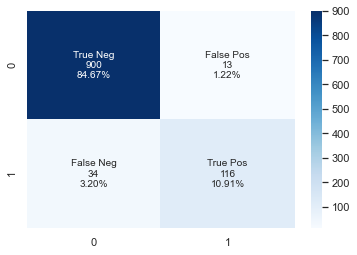

In [284]:
Cat_model1_SMOTE = CatBoostClassifier()
evaluate_model(X_train_Smote,y_train_Smote,Cat_model1_SMOTE)

## Hyperparameter tunning - GridSearchCV

binary classification:Logloss

probabilities in target : CrossEntropy

## 25.CatBoostClassifier Using GridSearch 

In [285]:
from catboost import CatBoostClassifier
CBC_Gridcv = CatBoostClassifier(
    iterations=500,
    depth=7,random_seed=63,
    learning_rate=0.1,
    verbose=10,
    custom_loss=['AUC', 'Accuracy']
    #use_best_model=True
    # loss_function='CrossEntropy'
)
CBC_Gridcv.fit(
    X_train, y_train,
    eval_set=(X_test, y_test),
    verbose=False,
    plot=True
)
print('Model is fitted: ' + str(CBC_Gridcv.is_fitted()))
print('Model params:')
print(CBC_Gridcv.get_params())

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Model is fitted: True
Model params:
{'iterations': 500, 'learning_rate': 0.1, 'depth': 7, 'random_seed': 63, 'verbose': 10, 'custom_loss': ['AUC', 'Accuracy']}


### Model predictions

0:	learn: 0.5712326	total: 12.1ms	remaining: 6.04s
10:	learn: 0.2307616	total: 112ms	remaining: 4.98s
20:	learn: 0.1670397	total: 227ms	remaining: 5.17s
30:	learn: 0.1380813	total: 342ms	remaining: 5.17s
40:	learn: 0.1240058	total: 455ms	remaining: 5.09s
50:	learn: 0.1143304	total: 557ms	remaining: 4.9s
60:	learn: 0.1059570	total: 635ms	remaining: 4.57s
70:	learn: 0.1006581	total: 735ms	remaining: 4.44s
80:	learn: 0.0949339	total: 804ms	remaining: 4.16s
90:	learn: 0.0898496	total: 866ms	remaining: 3.89s
100:	learn: 0.0851160	total: 931ms	remaining: 3.68s
110:	learn: 0.0810401	total: 1.04s	remaining: 3.65s
120:	learn: 0.0774591	total: 1.1s	remaining: 3.46s
130:	learn: 0.0718447	total: 1.21s	remaining: 3.41s
140:	learn: 0.0677479	total: 1.28s	remaining: 3.26s
150:	learn: 0.0639169	total: 1.34s	remaining: 3.11s
160:	learn: 0.0597580	total: 1.41s	remaining: 2.97s
170:	learn: 0.0565429	total: 1.51s	remaining: 2.91s
180:	learn: 0.0535563	total: 1.58s	remaining: 2.78s
190:	learn: 0.0511739	to

80:	learn: 0.0839755	total: 539ms	remaining: 2.79s
90:	learn: 0.0789228	total: 601ms	remaining: 2.7s
100:	learn: 0.0739823	total: 662ms	remaining: 2.61s
110:	learn: 0.0685484	total: 718ms	remaining: 2.52s
120:	learn: 0.0624455	total: 799ms	remaining: 2.5s
130:	learn: 0.0577142	total: 862ms	remaining: 2.43s
140:	learn: 0.0526508	total: 921ms	remaining: 2.35s
150:	learn: 0.0497115	total: 980ms	remaining: 2.27s
160:	learn: 0.0466903	total: 1.06s	remaining: 2.24s
170:	learn: 0.0430836	total: 1.12s	remaining: 2.16s
180:	learn: 0.0392808	total: 1.2s	remaining: 2.11s
190:	learn: 0.0364998	total: 1.25s	remaining: 2.03s
200:	learn: 0.0332238	total: 1.34s	remaining: 2s
210:	learn: 0.0314903	total: 1.4s	remaining: 1.92s
220:	learn: 0.0295228	total: 1.46s	remaining: 1.84s
230:	learn: 0.0277328	total: 1.52s	remaining: 1.77s
240:	learn: 0.0265117	total: 1.6s	remaining: 1.72s
250:	learn: 0.0244594	total: 1.67s	remaining: 1.65s
260:	learn: 0.0234599	total: 1.72s	remaining: 1.58s
270:	learn: 0.0222924	

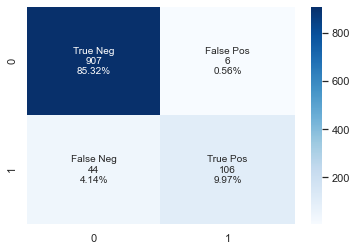

In [286]:
#Predicsions after hyperparameter tunning
evaluate_model(X_train,y_train,CBC_Gridcv) 

## 26.CatBoostClassifier Using GridSearch-SMOTE

In [287]:
CBC_Gridcv_Smote = CatBoostClassifier(
    iterations=500,
    depth=7,random_seed=63,
    learning_rate=0.1,
    verbose=10,
    custom_loss=['AUC', 'Accuracy']
    #use_best_model=True
    # loss_function='CrossEntropy'
)
CBC_Gridcv_Smote.fit(
    X_train_Smote, y_train_Smote,
    eval_set=(X_test, y_test),
    verbose=False,
    plot=True
)
print('Model is fitted: ' + str(CBC_Gridcv_Smote.is_fitted()))
print('Model params:')
print(CBC_Gridcv_Smote.get_params())


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Model is fitted: True
Model params:
{'iterations': 500, 'learning_rate': 0.1, 'depth': 7, 'random_seed': 63, 'verbose': 10, 'custom_loss': ['AUC', 'Accuracy']}


0:	learn: 0.6265718	total: 16.3ms	remaining: 8.11s
10:	learn: 0.3318403	total: 162ms	remaining: 7.2s
20:	learn: 0.2385333	total: 359ms	remaining: 8.18s
30:	learn: 0.1978837	total: 522ms	remaining: 7.89s
40:	learn: 0.1694679	total: 693ms	remaining: 7.75s
50:	learn: 0.1504290	total: 815ms	remaining: 7.18s
60:	learn: 0.1353794	total: 924ms	remaining: 6.65s
70:	learn: 0.1263234	total: 1.06s	remaining: 6.4s
80:	learn: 0.1166409	total: 1.18s	remaining: 6.09s
90:	learn: 0.1053643	total: 1.29s	remaining: 5.81s
100:	learn: 0.0948699	total: 1.4s	remaining: 5.52s
110:	learn: 0.0873957	total: 1.52s	remaining: 5.35s
120:	learn: 0.0802915	total: 1.63s	remaining: 5.12s
130:	learn: 0.0743504	total: 1.75s	remaining: 4.94s
140:	learn: 0.0701598	total: 1.86s	remaining: 4.74s
150:	learn: 0.0657041	total: 1.98s	remaining: 4.58s
160:	learn: 0.0622797	total: 2.08s	remaining: 4.38s
170:	learn: 0.0587584	total: 2.21s	remaining: 4.25s
180:	learn: 0.0560982	total: 2.32s	remaining: 4.08s
190:	learn: 0.0535840	tot

70:	learn: 0.1441713	total: 717ms	remaining: 4.33s
80:	learn: 0.1347951	total: 803ms	remaining: 4.15s
90:	learn: 0.1233629	total: 888ms	remaining: 3.99s
100:	learn: 0.1148941	total: 1s	remaining: 3.95s
110:	learn: 0.1054006	total: 1.08s	remaining: 3.81s
120:	learn: 0.0955780	total: 1.17s	remaining: 3.67s
130:	learn: 0.0859722	total: 1.29s	remaining: 3.63s
140:	learn: 0.0804623	total: 1.37s	remaining: 3.5s
150:	learn: 0.0757543	total: 1.46s	remaining: 3.37s
160:	learn: 0.0713326	total: 1.57s	remaining: 3.31s
170:	learn: 0.0655532	total: 1.66s	remaining: 3.19s
180:	learn: 0.0626975	total: 1.74s	remaining: 3.07s
190:	learn: 0.0587066	total: 1.86s	remaining: 3s
200:	learn: 0.0552636	total: 1.94s	remaining: 2.89s
210:	learn: 0.0525619	total: 2.03s	remaining: 2.78s
220:	learn: 0.0504038	total: 2.14s	remaining: 2.7s
230:	learn: 0.0476893	total: 2.23s	remaining: 2.59s
240:	learn: 0.0451153	total: 2.32s	remaining: 2.49s
250:	learn: 0.0431704	total: 2.43s	remaining: 2.41s
260:	learn: 0.0412421	t

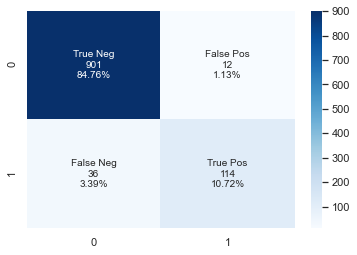

In [288]:
evaluate_model(X_train_Smote,y_train_Smote,CBC_Gridcv_Smote)

## 27.Keras-Classification

In [289]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation,Dropout

In [290]:
keras = Sequential()

# https://stats.stackexchange.com/questions/181/how-to-choose-the-number-of-hidden-layers-and-nodes-in-a-feedforward-neural-netw

keras.add(Dense(units=30,activation='relu'))

keras.add(Dense(units=15,activation='relu'))


keras.add(Dense(units=1,activation='sigmoid'))

# For a binary classification problem
keras.compile(loss='binary_crossentropy', optimizer='adam')

In [291]:
keras.fit(x=X_train, 
          y=y_train, 
          epochs=100,
          validation_data=(X_test, y_test), verbose=1
          )

Epoch 1/100

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

100/100 [==============================] - 0s 4ms/step - loss: 0.4460 - val_loss: 0.3971
Epoch 2/100
100/100 [==============================] - 0s 2ms/step - loss: 0.3854 - val_loss: 0.3807
Epoch 3/100
100/100 [==============================] - 0s 4ms/step - loss: 0.3639 - val_loss: 0.3714
Epoch 4/100
100/100 [==============================] - 0s 3ms/step - loss: 0.3479 - val_loss: 0.3677
Epoch 5/100
100/100 [==============================] - 0s 4ms/step - loss: 0.3340 - val_loss: 0.3555
Epo

100/100 [==============================] - 0s 3ms/step - loss: 0.1003 - val_loss: 0.4490
Epoch 75/100
100/100 [==============================] - 0s 3ms/step - loss: 0.0975 - val_loss: 0.4519
Epoch 76/100
100/100 [==============================] - 0s 3ms/step - loss: 0.0972 - val_loss: 0.4512
Epoch 77/100
100/100 [==============================] - 0s 3ms/step - loss: 0.0941 - val_loss: 0.4669
Epoch 78/100
100/100 [==============================] - 0s 3ms/step - loss: 0.0916 - val_loss: 0.4560
Epoch 79/100
100/100 [==============================] - 0s 3ms/step - loss: 0.0931 - val_loss: 0.4649
Epoch 80/100
100/100 [==============================] - 0s 2ms/step - loss: 0.0918 - val_loss: 0.4674
Epoch 81/100
100/100 [==============================] - 0s 3ms/step - loss: 0.0885 - val_loss: 0.4983
Epoch 82/100
100/100 [==============================] - 0s 3ms/step - loss: 0.0901 - val_loss: 0.4720
Epoch 83/100
100/100 [==============================] - 0s 3ms/step - loss: 0.0884 - val_loss: 

In [292]:
keras_loss = pd.DataFrame(keras.history.history)
keras_loss

,loss,val_loss
0,0.446042,0.397074
1,0.385429,0.380736
2,0.363923,0.371420
3,0.347913,0.367655
4,0.333965,0.355463
...,...,...
95,0.078130,0.538915
96,0.074038,0.543760
97,0.075103,0.542915
98,0.071317,0.545968


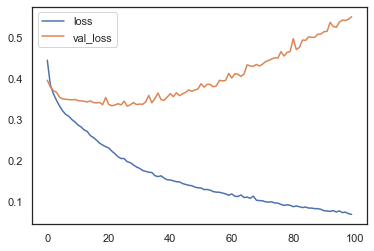

In [293]:
keras_loss.plot()

In [294]:
#Early Stopping
keras = Sequential()
keras.add(Dense(units=30,activation='relu'))
keras.add(Dense(units=15,activation='relu'))
keras.add(Dense(units=1,activation='sigmoid'))
keras.compile(loss='binary_crossentropy', optimizer='adam')

In [295]:
from tensorflow.keras.callbacks import EarlyStopping

Stop training when a monitored quantity has stopped improving.

    Arguments:
        monitor: Quantity to be monitored.
        min_delta: Minimum change in the monitored quantity
            to qualify as an improvement, i.e. an absolute
            change of less than min_delta, will count as no
            improvement.
        patience: Number of epochs with no improvement
            after which training will be stopped.
        verbose: verbosity mode.
        mode: One of `{"auto", "min", "max"}`. In `min` mode,
            training will stop when the quantity
            monitored has stopped decreasing; in `max`
            mode it will stop when the quantity
            monitored has stopped increasing; in `auto`
            mode, the direction is automatically inferred
            from the name of the monitored quantity.

In [296]:
early_stop = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=25)
keras.fit(x=X_train, 
          y=y_train, 
          epochs=100,
          validation_data=(X_test, y_test), verbose=1,
          callbacks=[early_stop]
          )

Epoch 1/100

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

100/100 [==============================] - 0s 4ms/step - loss: 0.4452 - val_loss: 0.3956
Epoch 2/100
100/100 [==============================] - 0s 3ms/step - loss: 0.3789 - val_loss: 0.3768
Epoch 3/100
100/100 [==============================] - 0s 3ms/step - loss: 0.3556 - val_loss: 0.3605
Epoch 4/100
100/100 [==============================] - 1s 5ms/step - loss: 0.3369 - val_loss: 0.3539
Epoch 5/100
100/100 [==============================] - 0s 3ms/step - loss: 0.3255 - val_loss: 0.3537
Epo

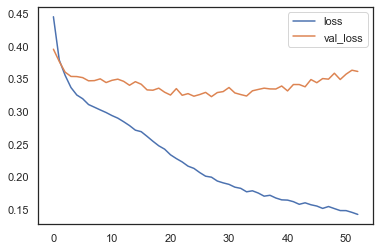

In [297]:
model_loss = pd.DataFrame(keras.history.history)
model_loss.plot()

#### Adding in DropOut Layers

In [298]:
from tensorflow.keras.layers import Dropout
keras = Sequential()
keras.add(Dense(units=30,activation='relu'))
keras.add(Dropout(0.5))

keras.add(Dense(units=15,activation='relu'))
keras.add(Dropout(0.5))

keras.add(Dense(units=1,activation='sigmoid'))
keras.compile(loss='binary_crossentropy', optimizer='adam')

In [299]:
keras.fit(x=X_train, 
          y=y_train, 
          epochs=100,
          validation_data=(X_test, y_test), verbose=1,
          callbacks=[early_stop]
          )

Epoch 1/100

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

100/100 [==============================] - 0s 4ms/step - loss: 0.5148 - val_loss: 0.4073
Epoch 2/100
100/100 [==============================] - 0s 3ms/step - loss: 0.4480 - val_loss: 0.3961
Epoch 3/100
100/100 [==============================] - 0s 3ms/step - loss: 0.4266 - val_loss: 0.3884
Epoch 4/100
100/100 [==============================] - 0s 3ms/step - loss: 0.4176 - val_loss: 0.3778
Epoch 5/100
100/100 [==============================] - 0s 3ms/step - loss: 0.4018 - val_loss: 0.3731
Epo

100/100 [==============================] - 0s 3ms/step - loss: 0.2496 - val_loss: 0.3533
Epoch 75/100
100/100 [==============================] - 0s 3ms/step - loss: 0.2486 - val_loss: 0.3486
Epoch 76/100
100/100 [==============================] - 0s 5ms/step - loss: 0.2277 - val_loss: 0.3473
Epoch 77/100
100/100 [==============================] - 0s 3ms/step - loss: 0.2501 - val_loss: 0.3517
Epoch 78/100
100/100 [==============================] - 0s 3ms/step - loss: 0.2529 - val_loss: 0.3387
Epoch 79/100
100/100 [==============================] - 0s 3ms/step - loss: 0.2500 - val_loss: 0.3441
Epoch 80/100
100/100 [==============================] - 0s 3ms/step - loss: 0.2375 - val_loss: 0.3600
Epoch 81/100
100/100 [==============================] - 0s 3ms/step - loss: 0.2364 - val_loss: 0.3435
Epoch 82/100
100/100 [==============================] - 0s 3ms/step - loss: 0.2455 - val_loss: 0.3420
Epoch 83/100
100/100 [==============================] - 0s 3ms/step - loss: 0.2412 - val_loss: 

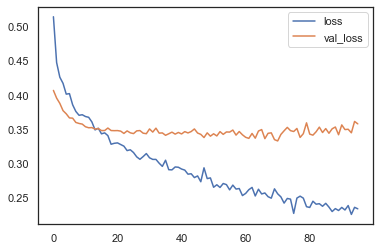

In [300]:
keras_loss = pd.DataFrame(keras.history.history)
keras_loss.plot()

In [301]:
#Model evaluation
predictions = keras.predict_classes(X_test)
predictions

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]], dtype=int32)

Keras accuracy score: 0.8908748824082785
------------------------------------------------------------------
------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.90      0.98      0.94       913
           1       0.77      0.33      0.46       150

    accuracy                           0.89      1063
   macro avg       0.83      0.66      0.70      1063
weighted avg       0.88      0.89      0.87      1063



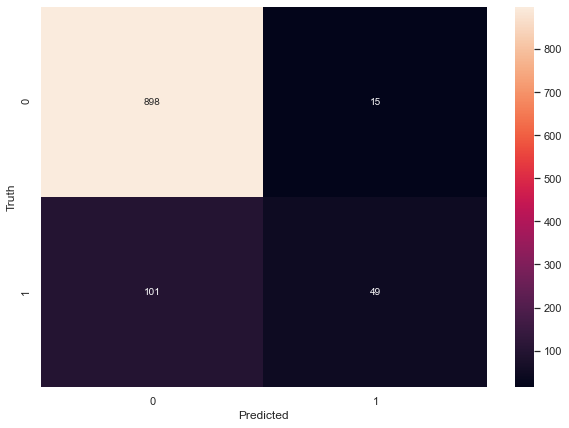

In [302]:
from sklearn.metrics import classification_report, confusion_matrix   
from sklearn.metrics import accuracy_score
Keras_Accuracy = accuracy_score(y_test,predictions)
print('Keras accuracy score:',Keras_Accuracy)
print('------------------------------------------------------------------')
#Confusion Matrix 1
cm = tf.math.confusion_matrix(labels=y_test,predictions=predictions)

plt.figure(figsize = (10,7))
sns.heatmap(cm, annot=True, fmt='d')
plt.xlabel('Predicted')
plt.ylabel('Truth')

print('------------------------------------------------------------------')
print(classification_report(y_test,predictions))


## 28. Keras with Smote

In [303]:
keras_Smote = Sequential()

In [304]:


# https://stats.stackexchange.com/questions/181/how-to-choose-the-number-of-hidden-layers-and-nodes-in-a-feedforward-neural-netw

keras_Smote.add(Dense(units=30,activation='relu'))

keras_Smote.add(Dense(units=15,activation='relu'))


keras_Smote.add(Dense(units=1,activation='sigmoid'))

# For a binary classification problem
keras_Smote.compile(loss='binary_crossentropy', optimizer='adam')

In [305]:

keras_Smote.fit(x=X_train_Smote, 
          y=y_train_Smote, 
          epochs=100,
          validation_data=(X_test, y_test), verbose=1,
          callbacks=[early_stop]
          )

Epoch 1/100

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

172/172 [==============================] - 1s 4ms/step - loss: 0.6423 - val_loss: 0.6245
Epoch 2/100
172/172 [==============================] - 1s 3ms/step - loss: 0.5108 - val_loss: 0.5387
Epoch 3/100
172/172 [==============================] - 0s 3ms/step - loss: 0.4177 - val_loss: 0.5253
Epoch 4/100
172/172 [==============================] - 1s 3ms/step - loss: 0.3791 - val_loss: 0.5307
Epoch 5/100
172/172 [==============================] - 0s 2ms/step - loss: 0.3506 - val_loss: 0.4381
Epo

In [306]:
keras_Smote_loss = pd.DataFrame(keras_Smote.history.history)
keras_Smote_loss

,loss,val_loss
0,0.642307,0.624484
1,0.510799,0.538660
2,0.417697,0.525256
3,0.379126,0.530708
4,0.350597,0.438093
5,0.336016,0.445827
6,0.317090,0.442030
7,0.301452,0.441823
8,0.289560,0.451844
9,0.274943,0.458312


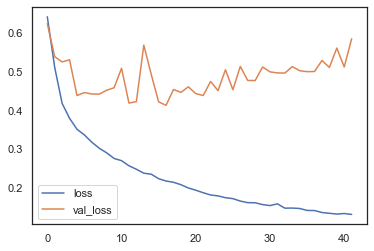

In [307]:
keras_Smote_loss.plot()

In [308]:
#Early Stopping
keras_Smote = Sequential()
keras_Smote.add(Dense(units=30,activation='relu'))
keras_Smote.add(Dense(units=15,activation='relu'))
keras_Smote.add(Dense(units=1,activation='sigmoid'))
keras_Smote.compile(loss='binary_crossentropy', optimizer='adam')

In [309]:
from tensorflow.keras.callbacks import EarlyStopping

In [310]:
early_stop = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=25)
keras_Smote.fit(x=X_train_Smote, 
          y=y_train_Smote, 
          epochs=100,
          validation_data=(X_test, y_test), verbose=1,
          callbacks=[early_stop]
          )

Epoch 1/100

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

172/172 [==============================] - 0s 2ms/step - loss: 0.6596 - val_loss: 0.6291
Epoch 2/100
172/172 [==============================] - 0s 2ms/step - loss: 0.5140 - val_loss: 0.5308
Epoch 3/100
172/172 [==============================] - 0s 2ms/step - loss: 0.4226 - val_loss: 0.5202
Epoch 4/100
172/172 [==============================] - 0s 2ms/step - loss: 0.3861 - val_loss: 0.4826
Epoch 5/100
172/172 [==============================] - 0s 2ms/step - loss: 0.3591 - val_loss: 0.5522
Epo

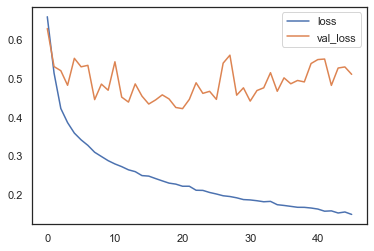

In [311]:
model_loss = pd.DataFrame(keras_Smote.history.history)
model_loss.plot()

### Adding dropout layers

In [312]:
from tensorflow.keras.layers import Dropout
keras_Smote = Sequential()
keras_Smote.add(Dense(units=30,activation='relu'))
keras_Smote.add(Dropout(0.5))

keras_Smote.add(Dense(units=15,activation='relu'))
keras_Smote.add(Dropout(0.5))

keras_Smote.add(Dense(units=1,activation='sigmoid'))
keras_Smote.compile(loss='binary_crossentropy', optimizer='adam')

In [313]:
keras_Smote.fit(x=X_train_Smote, 
          y=y_train_Smote, 
          epochs=100,
          validation_data=(X_test, y_test), verbose=1,
          callbacks=[early_stop]
          )

Epoch 1/100

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

172/172 [==============================] - 0s 3ms/step - loss: 0.6869 - val_loss: 0.6545
Epoch 2/100
172/172 [==============================] - 0s 2ms/step - loss: 0.6639 - val_loss: 0.6256
Epoch 3/100
172/172 [==============================] - 0s 2ms/step - loss: 0.6216 - val_loss: 0.5783
Epoch 4/100
172/172 [==============================] - 0s 2ms/step - loss: 0.5731 - val_loss: 0.5422
Epoch 5/100
172/172 [==============================] - 0s 2ms/step - loss: 0.5378 - val_loss: 0.4696
Epo

172/172 [==============================] - 0s 2ms/step - loss: 0.2577 - val_loss: 0.4145
Epoch 75/100
172/172 [==============================] - 0s 2ms/step - loss: 0.2540 - val_loss: 0.4106
Epoch 76/100
172/172 [==============================] - 0s 2ms/step - loss: 0.2517 - val_loss: 0.4125
Epoch 77/100
172/172 [==============================] - 0s 2ms/step - loss: 0.2470 - val_loss: 0.4099
Epoch 78/100
172/172 [==============================] - 0s 2ms/step - loss: 0.2465 - val_loss: 0.4083
Epoch 79/100
172/172 [==============================] - 0s 2ms/step - loss: 0.2440 - val_loss: 0.4053
Epoch 80/100
172/172 [==============================] - 0s 2ms/step - loss: 0.2525 - val_loss: 0.4105
Epoch 81/100
172/172 [==============================] - 0s 2ms/step - loss: 0.2429 - val_loss: 0.4457
Epoch 82/100
172/172 [==============================] - 0s 2ms/step - loss: 0.2427 - val_loss: 0.4253
Epoch 83/100
172/172 [==============================] - 0s 2ms/step - loss: 0.2533 - val_loss: 

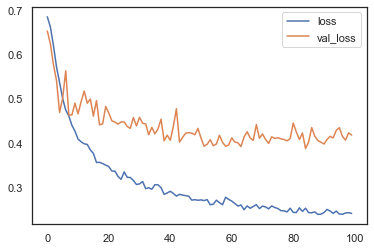

In [314]:
keras_Smote_loss = pd.DataFrame(keras_Smote.history.history)
keras_Smote_loss.plot()

In [315]:
#Model evaluation
predictions = keras_Smote.predict_classes(X_test).ravel()


Keras accuracy score: 0.8419567262464722
              precision    recall  f1-score   support

           0       0.92      0.90      0.91       913
           1       0.45      0.50      0.47       150

    accuracy                           0.84      1063
   macro avg       0.68      0.70      0.69      1063
weighted avg       0.85      0.84      0.85      1063



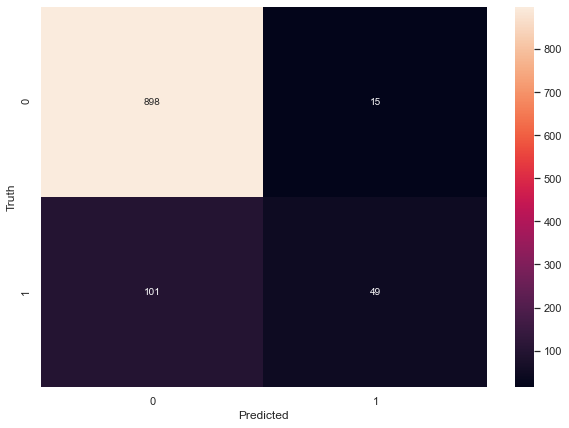

In [316]:
from sklearn.metrics import classification_report, confusion_matrix   
from sklearn.metrics import accuracy_score
Keras_Smote_Accuracy = accuracy_score(y_test,predictions)
print('Keras accuracy score:',Keras_Smote_Accuracy)

cm_Smote = tf.math.confusion_matrix(labels=y_test,predictions=predictions)

plt.figure(figsize = (10,7))
sns.heatmap(cm, annot=True, fmt='d')
plt.xlabel('Predicted')
plt.ylabel('Truth')


print(classification_report(y_test,predictions))



## Models Summary reports

In [317]:
## Import Libraries
import itertools

import numpy as np
import pandas as pd

%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns

from sklearn import model_selection
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import average_precision_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

import warnings
warnings.filterwarnings('ignore')

In [318]:
def show_summary_report(actual, prediction, probabilities):

    if isinstance(actual, pd.Series):
        actual = actual.values
    if actual.dtype.name == 'object':
        actual = actual.astype(int)
    if prediction.dtype.name == 'object':
        prediction = prediction.astype(int)

    accuracy_ = accuracy_score(actual, prediction)
    precision_ = precision_score(actual, prediction)
    recall_ = recall_score(actual, prediction)
    roc_auc_ = roc_auc_score(actual, probabilities[:, 1])

    print('Accuracy : %.4f [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0' % accuracy_)
    print('Precision: %.4f [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0' % precision_)
    print('Recall   : %.4f [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0' % recall_)
    print('ROC AUC  : %.4f                                                                     Best: 1, Worst: < 0.5' % roc_auc_)
    print('-' * 107)
    print('TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples')

    # Confusion Matrix
    mat = confusion_matrix(actual, prediction)

    # Precision/Recall
    precision, recall, _ = precision_recall_curve(actual, prediction)
    average_precision = average_precision_score(actual, prediction)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(actual, probabilities[:, 1])
    roc_auc = auc(fpr, tpr)

    # plot
    fig, ax = plt.subplots(1, 3, figsize = (20, 8))
    fig.subplots_adjust(left = 0.02, right = 0.98, wspace = 0.2)

    # Confusion Matrix
    sns.heatmap(mat.T, square = True, annot = True, fmt = 'd', cbar = False, cmap = 'coolwarm', ax = ax[0])

    ax[0].set_title('Confusion Matrix')
    ax[0].set_xlabel('True label')
    ax[0].set_ylabel('Predicted label')
    
    # Precision/Recall
    step_kwargs = {'step': 'post'}
    ax[1].step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
    ax[1].fill_between(recall, precision, alpha = 0.2, color = 'b', **step_kwargs)
    ax[1].set_ylim([0.0, 1.0])
    ax[1].set_xlim([0.0, 1.0])
    ax[1].set_xlabel('Recall')
    ax[1].set_ylabel('Precision')
    ax[1].set_title('2-class Precision-Recall curve')

    # ROC
    ax[2].plot(fpr, tpr, color = 'darkorange', lw = 2, label = 'ROC curve (AUC = %0.2f)' % roc_auc)
    ax[2].plot([0, 1], [0, 1], color = 'navy', lw = 2, linestyle = '--')
    ax[2].set_xlim([0.0, 1.0])
    ax[2].set_ylim([0.0, 1.0])
    ax[2].set_xlabel('False Positive Rate')
    ax[2].set_ylabel('True Positive Rate')
    ax[2].set_title('Receiver Operating Characteristic')
    ax[2].legend(loc = 'lower right')

    plt.show()
    
    return (accuracy_, precision_, recall_, roc_auc_)

-------
- SVM -
-------
Accuracy : 0.8589 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.0000 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.0000 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.7787                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


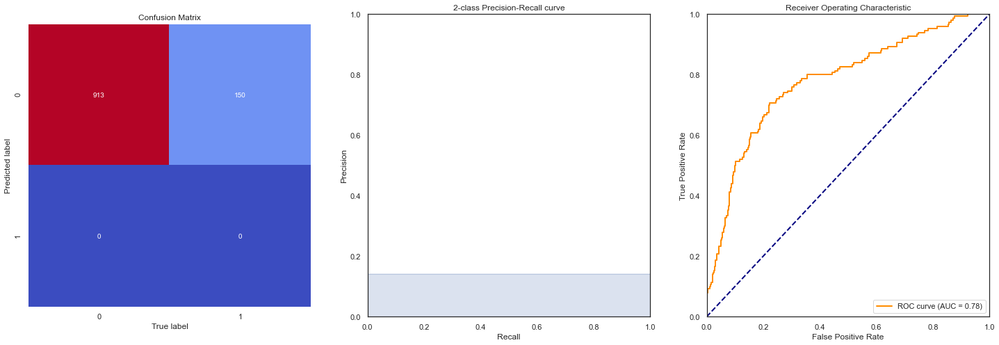


-------------
- SVM_SMOTE -
-------------
Accuracy : 0.7846 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.3564 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.6533 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.7739                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


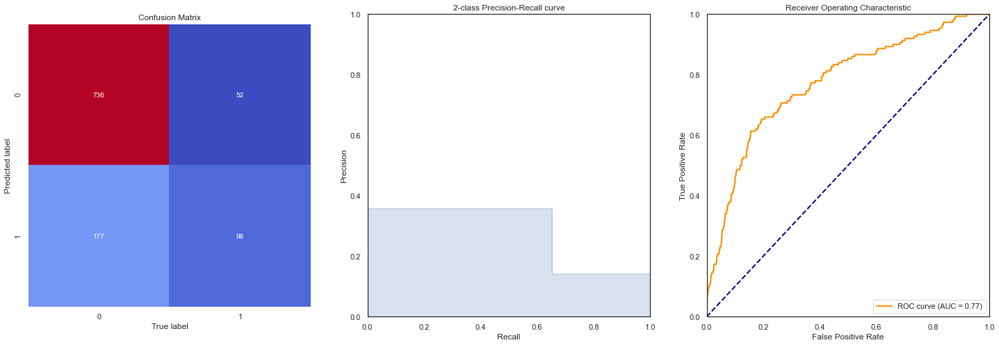


----------------------
- LogisticRegression -
----------------------
Accuracy : 0.8514 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.4487 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.2333 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.7920                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


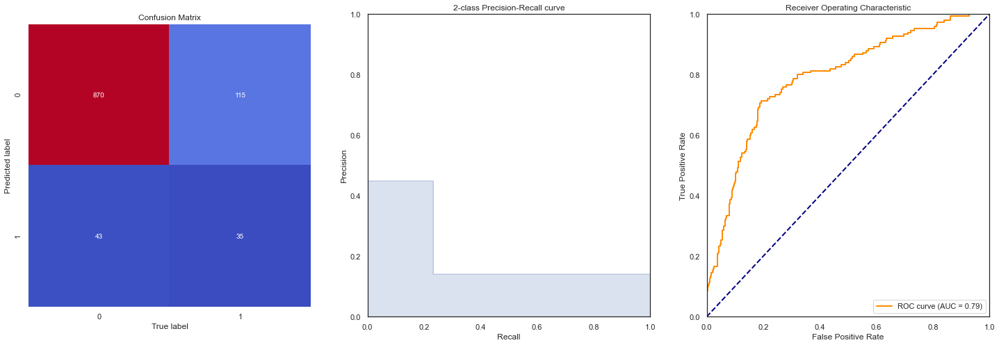


----------------------------
- LogisticRegression_SMOTE -
----------------------------
Accuracy : 0.7846 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.3498 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.6133 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.7644                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


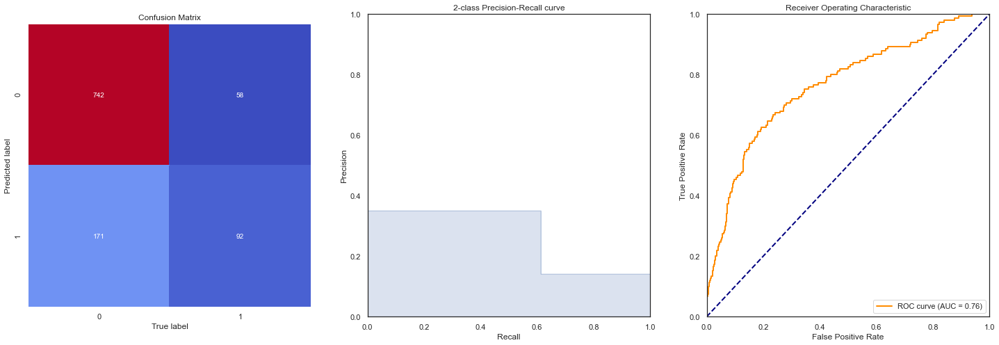


--------------
- GaussianNB -
--------------
Accuracy : 0.5569 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.1931 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.6733 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.6325                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


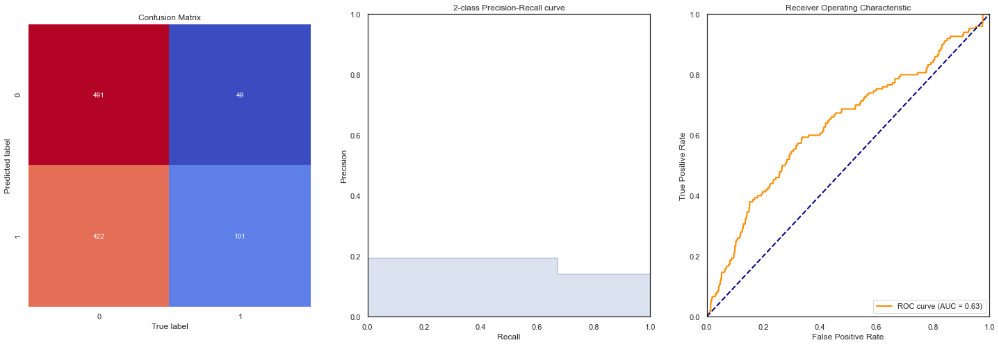


--------------------
- GaussianNB_SMOTE -
--------------------
Accuracy : 0.4807 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.1758 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7267 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.5987                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


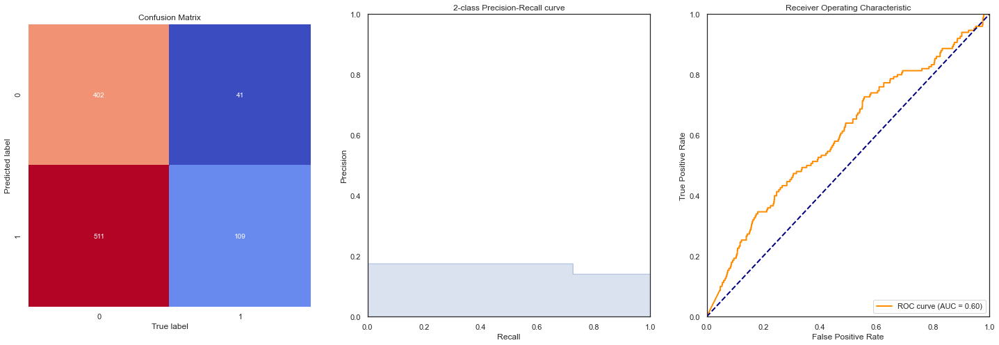


--------------------------
- DecisionTreeClassifier -
--------------------------
Accuracy : 0.9012 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.6433 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.6733 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8060                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


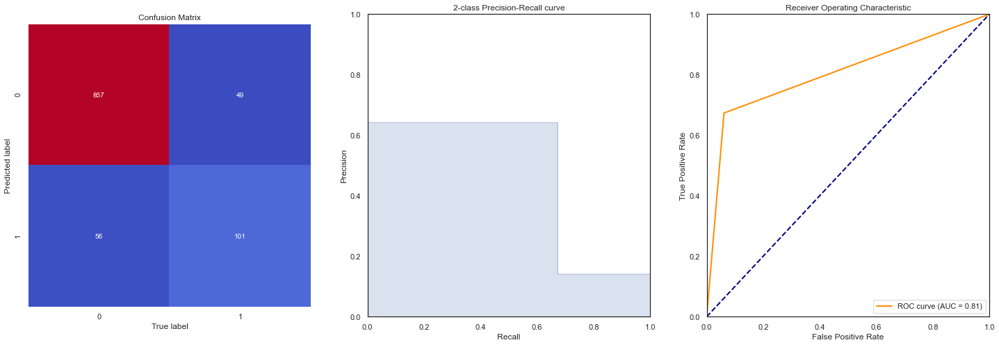


--------------------------------
- DecisionTreeClassifier_SMOTE -
--------------------------------
Accuracy : 0.8692 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.5266 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7267 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8097                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


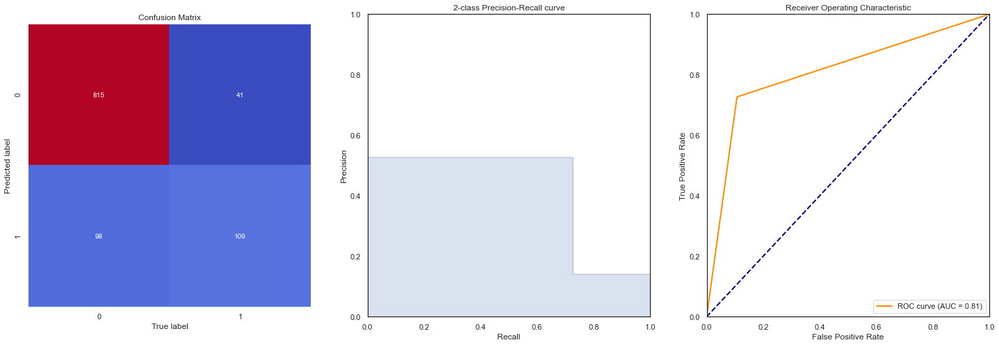


--------------------------
- RandomForestClassifier -
--------------------------
Accuracy : 0.9483 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 1.0000 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.6333 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9126                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


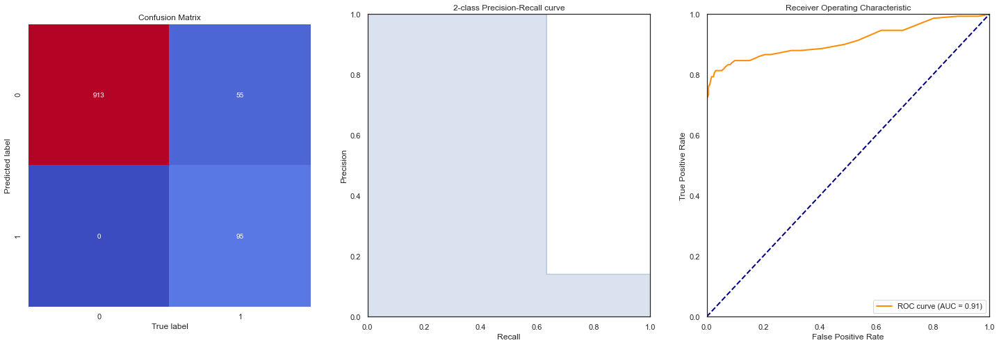


--------------------------------
- RandomForestClassifier_SMOTE -
--------------------------------
Accuracy : 0.9398 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.7986 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7667 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9094                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


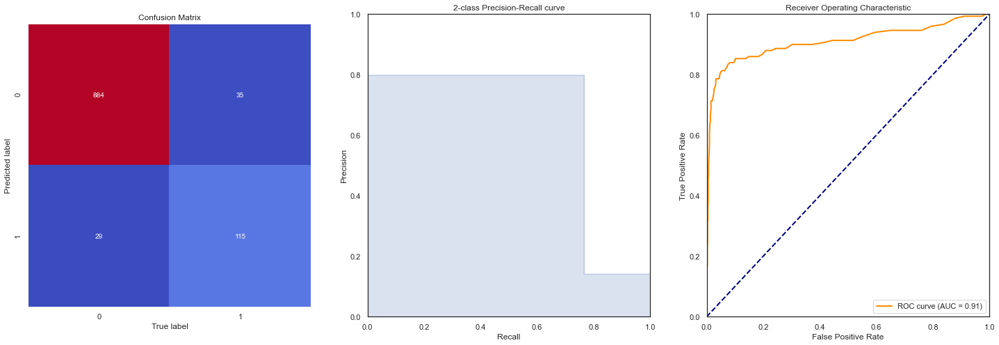


----------------------
- AdaBoostClassifier -
----------------------
Accuracy : 0.8843 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.6517 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.3867 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8480                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


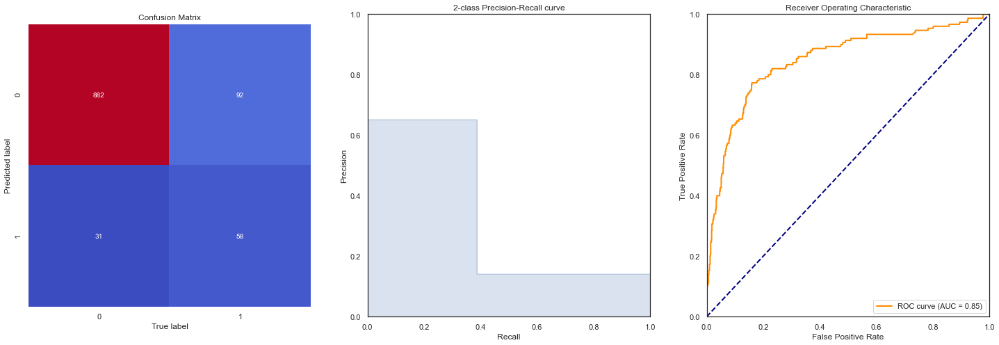


----------------------------
- AdaBoostClassifier_SMOTE -
----------------------------
Accuracy : 0.8504 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.4774 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.6333 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8306                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


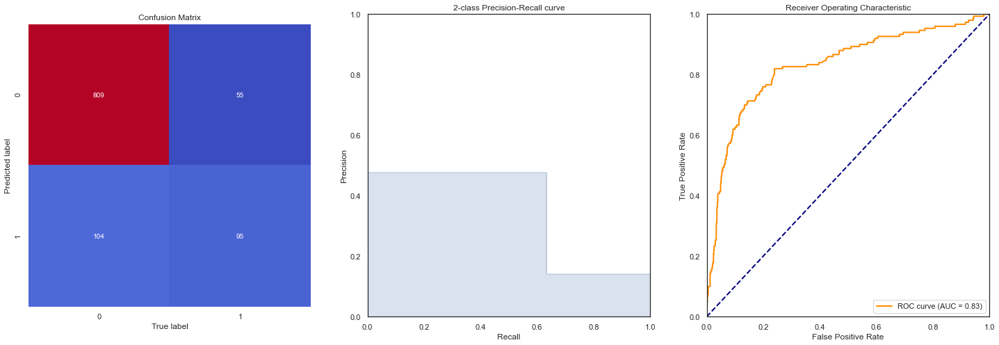


-----------------
- XGBClassifier -
-----------------
Accuracy : 0.9567 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9194 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7600 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9187                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


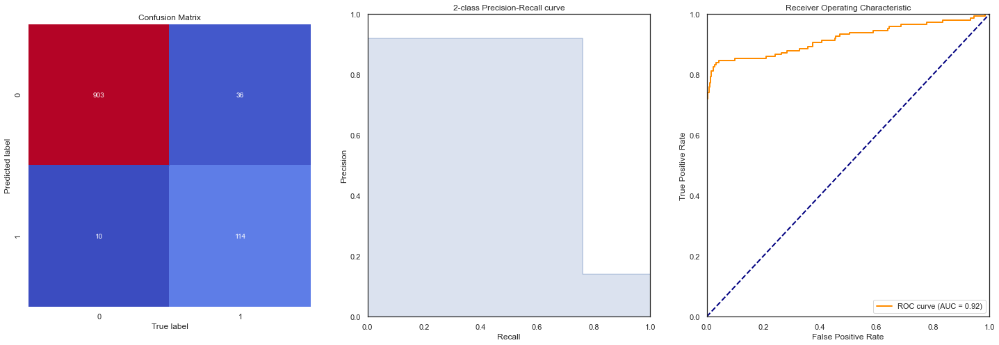


-----------------------
- XGBClassifier_SMOTE -
-----------------------
Accuracy : 0.9567 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.8939 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7867 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9253                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


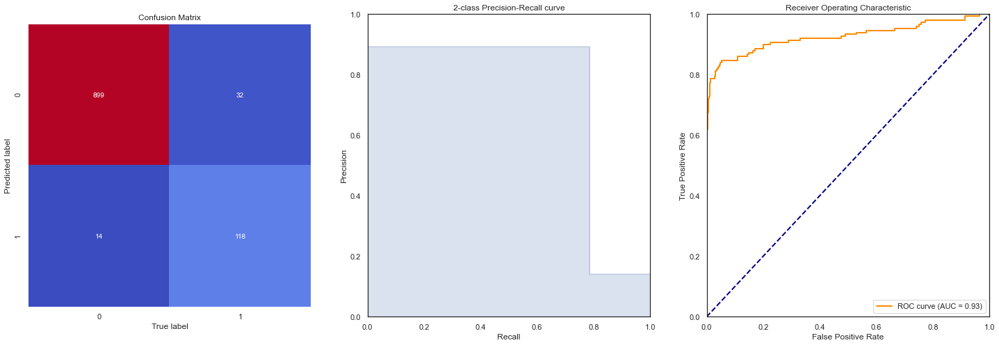


-------------------------
- XGBClassifier_GSearch -
-------------------------
Accuracy : 0.9614 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9504 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7667 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9124                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


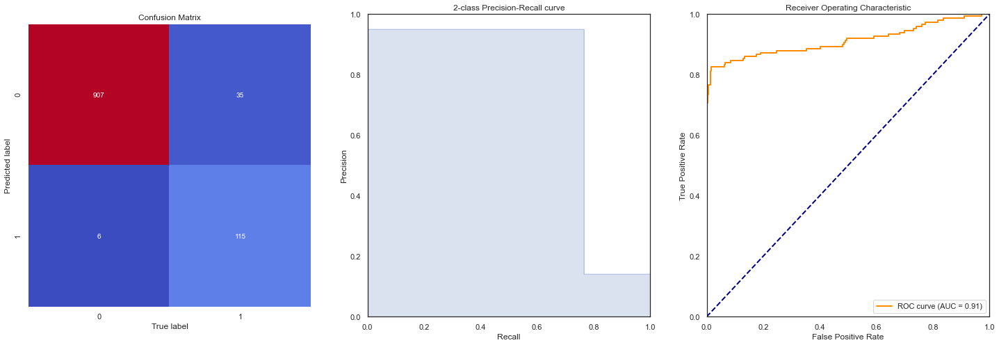


-------------------------------
- XGBClassifier_GSearch_SMOTE -
-------------------------------
Accuracy : 0.9577 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9268 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7600 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9109                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


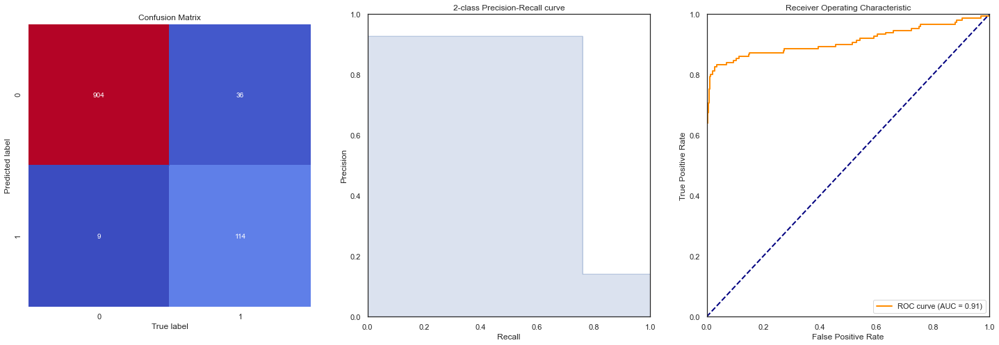


---------------------
- XGBClassifier_Opt -
---------------------
Accuracy : 0.9595 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9280 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7733 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9115                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


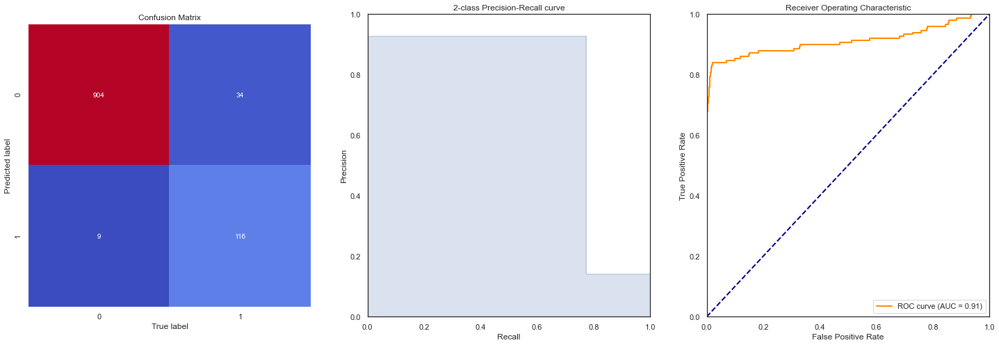


---------------------------
- XGBClassifier_Opt_SMOTE -
---------------------------
Accuracy : 0.9539 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.8686 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7933 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9211                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


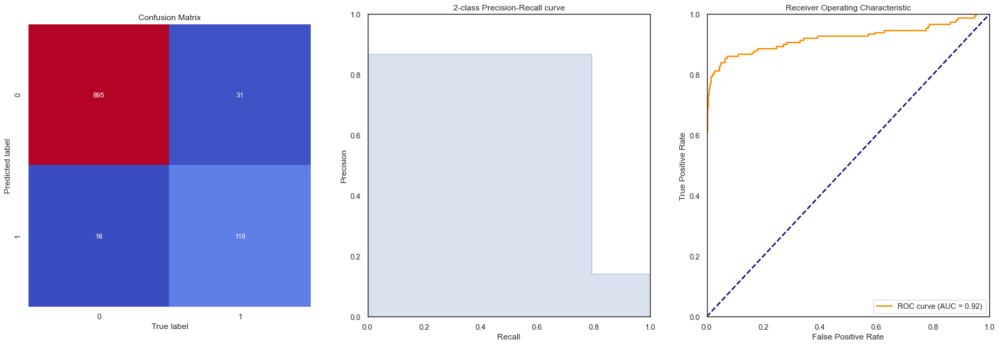


------------------------------
- RandomForestClassifier_Opt -
------------------------------
Accuracy : 0.9511 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9900 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.6600 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9105                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


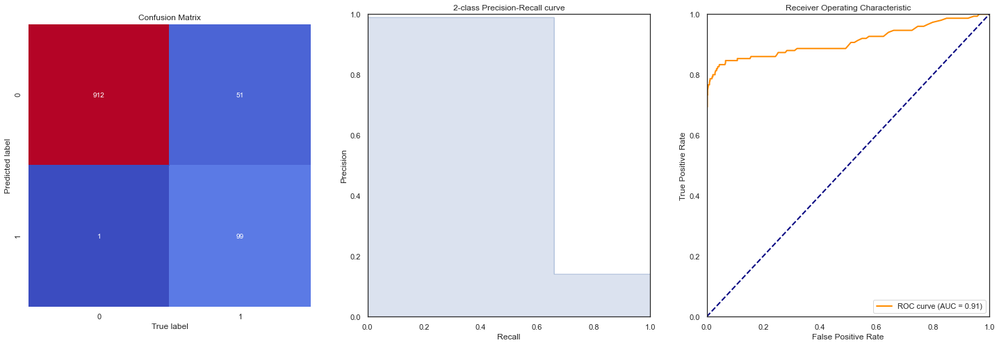


------------------------------------
- RandomForestClassifier_Opt_SMOTE -
------------------------------------
Accuracy : 0.9445 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.8138 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7867 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9156                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


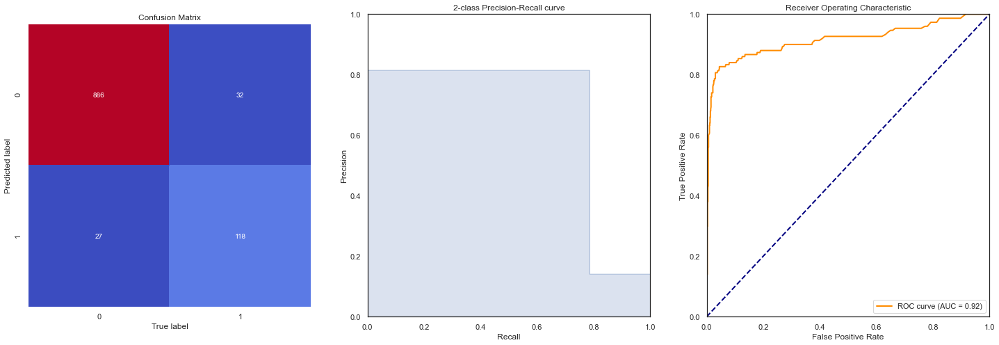


--------------
- Cat_model1 -
--------------
Accuracy : 0.9614 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9658 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7533 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9158                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


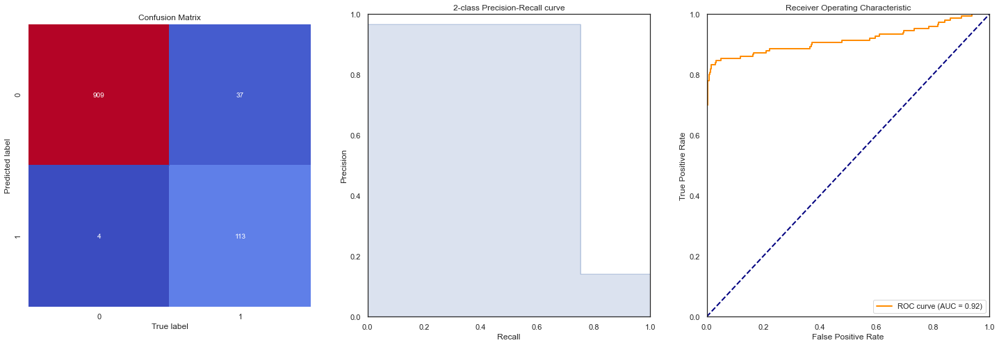


--------------------
- Cat_model1_SMOTE -
--------------------
Accuracy : 0.9558 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.8992 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7733 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9239                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


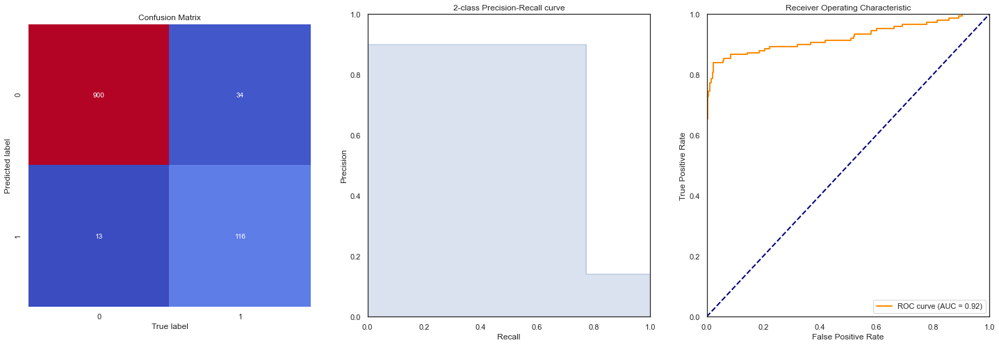


--------------
- CBC_Gridcv -
--------------
Accuracy : 0.9530 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9464 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7067 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9199                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


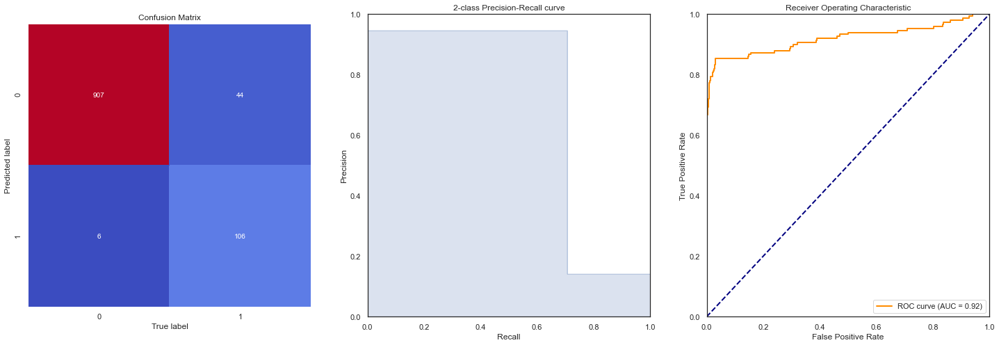


--------------------
- CBC_Gridcv_Smote -
--------------------
Accuracy : 0.9548 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.9048 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7600 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9214                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


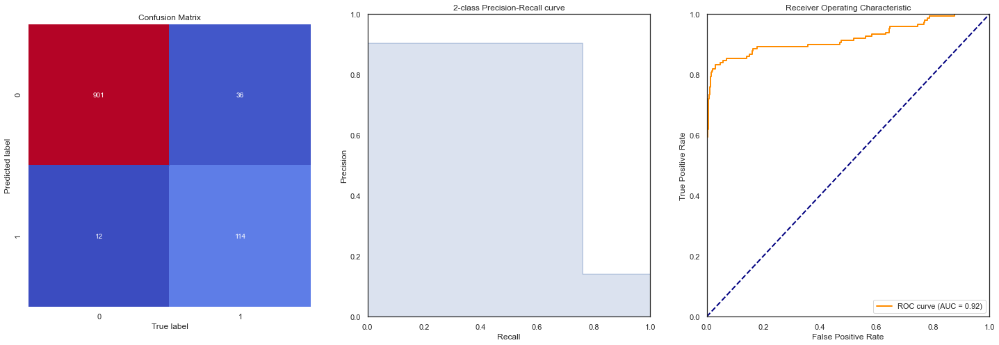

IndexError: list index out of range

In [320]:
# Keep the results in a dataframe
results = pd.DataFrame(columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'ROC_AUC'])

models = ['SVM','SVM_SMOTE','LogisticRegression','LogisticRegression_SMOTE','GaussianNB','GaussianNB_SMOTE',
          'DecisionTreeClassifier','DecisionTreeClassifier_SMOTE','RandomForestClassifier',
          'RandomForestClassifier_SMOTE',
          'AdaBoostClassifier','AdaBoostClassifier_SMOTE','XGBClassifier','XGBClassifier_SMOTE',
          'XGBClassifier_GSearch',
          'XGBClassifier_GSearch_SMOTE','XGBClassifier_Opt','XGBClassifier_Opt_SMOTE',
          'RandomForestClassifier_Opt','RandomForestClassifier_Opt_SMOTE','Cat_model1','Cat_model1_SMOTE',
          'CBC_Gridcv','CBC_Gridcv_Smote']

for i, m in enumerate([SVM,SVM_SMOTE,logmodel,logmodel_SMOTE,Gaussian,Gaussian_SMOTE,dt,dt_SMOTE,RFC,RFC_SMOTE,
                       ADA,ADA_SMOTE,gbm,gbm_SMOTE,xgb_grid,xgb_grid_SMOTE,gbm_optuna,
                       gbm_optuna_SMOTE,RFC_opt,RFC_opt_SMOTE,Cat_model1,Cat_model1_SMOTE,CBC_Gridcv,CBC_Gridcv_Smote,
                       keras,keras_Smote]):
    print('-' * (len(models[i]) + 4))
    print('- %s -' % models[i])
    print('-'*(len(models[i]) + 4))
    predictions = m.predict(X_test)
    probabilities = m.predict_proba(X_test)
    # show the report
    accuracy_, precision_, recall_, roc_auc_ = show_summary_report(y_test, predictions, probabilities)
    # keep the results
    results.loc[i] = {'Model': models[i], 
                      'Accuracy': accuracy_, 
                      'Precision': precision_,
                      'Recall': recall_,
                      'ROC_AUC': roc_auc_}
  
    print()    

In [321]:
results


,Model,Accuracy,Precision,Recall,ROC_AUC
0,SVM,0.858890,0.000000,0.000000,0.778744
1,SVM_SMOTE,0.784572,0.356364,0.653333,0.773888
2,LogisticRegression,0.851364,0.448718,0.233333,0.792019
3,LogisticRegression_SMOTE,0.784572,0.349810,0.613333,0.764432
4,GaussianNB,0.556914,0.193117,0.673333,0.632516
5,GaussianNB_SMOTE,0.480715,0.175806,0.726667,0.598715
6,DecisionTreeClassifier,0.901223,0.643312,0.673333,0.805999
7,DecisionTreeClassifier_SMOTE,0.869238,0.526570,0.726667,0.809664
8,RandomForestClassifier,0.948260,1.000000,0.633333,0.912643
9,RandomForestClassifier_SMOTE,0.939793,0.798611,0.766667,0.909423


In [118]:
results.sort_values(by=['Accuracy', 'Precision', 'Recall', 'ROC_AUC'], axis=0, ascending=False, inplace=False,kind='quicksort')


,Model,Accuracy,Precision,Recall,ROC_AUC
20,Cat_model1,0.961430,0.965812,0.753333,0.915831
14,XGBClassifier_GSearch,0.961430,0.950413,0.766667,0.912399
16,XGBClassifier_Opt,0.959548,0.928000,0.773333,0.911486
15,XGBClassifier_GSearch_SMOTE,0.957667,0.926829,0.760000,0.910851
12,XGBClassifier,0.956726,0.919355,0.760000,0.918722
13,XGBClassifier_SMOTE,0.956726,0.893939,0.786667,0.925287
21,Cat_model1_SMOTE,0.955786,0.899225,0.773333,0.923899
23,CBC_Gridcv_Smote,0.954845,0.904762,0.760000,0.921417
17,XGBClassifier_Opt_SMOTE,0.953904,0.868613,0.793333,0.921081
22,CBC_Gridcv,0.952963,0.946429,0.706667,0.919883


## Comparision of all the models with its best accuracy scores

In [119]:
import plotly.graph_objects as go

x = results['Model']
y = results['Accuracy']

# Use the hovertext kw argument for hover text
fig = go.Figure(data=[go.Bar(x=x, y=y)])
# Customize aspect
fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.6)
fig.update_layout(title_text='XGBoost,RandomForrest & Catboost accuracy scores ranges from 95% - 96%')
fig.show()

## Recall Scores Comparision

In [120]:
import plotly.graph_objects as go

x = results['Model']
y = results['Recall']

# Use the hovertext kw argument for hover text
fig = go.Figure(data=[go.Bar(x=x, y=y)])
# Customize aspect
fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.6)
fig.update_layout(title_text=' XGBoost & RandomForest gives the highest of 79 %  recall scores')
fig.show()

##  ROC - AUC Scores 

In [121]:
import plotly.graph_objects as go

x = results['Model']
y = results['ROC_AUC']

# Use the hovertext kw argument for hover text
fig = go.Figure(data=[go.Bar(x=x, y=y)])
# Customize aspect
fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.6)
fig.update_layout(title_text='XGBoost gives the highest of 92% ROC_AUC Score')
fig.show()

## Conclusion
### The final model for the deployment for 'Customer Churn Prediction' would be XGBoost model(XGBClassifier_Opt_SMOTE) the highest performance model interms of  its accuracy score, recall score,precision score and roc-auc score.